# New CVID data

### Analysis based on GEX and SoupX-denoised protein

08.01.2021, annotation

02.2021: reanalysis of twin data, after bertie bug correction

(Preprocessing happened in notebook M1)

Step-by-step workflow - **different to the scRNA-seq integration in doublet calling**:
- load preprocessed object
- do SCTransfor instead of normalising & log transforming
- save raw attribute to then be able to plot all genes on the HVG-subsetted dataset
- filter out cell cycle genes
- subset to HVGs
- (skipping scaling, not necessary because we've done SCTransform)
- pca (can also do preliminary neighbors/bbknn+umap here to peak at the data)
- **train a logreg model and add annotation (before it used to be earlier in the workflow)**
- neighbors/bbknn - deciding on which batch correction we will be using
- perform **step 2** of bertie doublet calling (requires running louvain clustering, see code)
- umap
- unbiased clustering
- save

In [1]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import numpy as np
import pandas as pd
import seaborn as sns
import scanpy as sc
from glob import iglob
import anndata
# need to do 'pip3 install bbknn==1.3.8' to avoid incompatibility errors
import bbknn
# requires 'pip install scrublet'
#import scrublet as scr
import os
import sklearn
from sklearn.linear_model import LogisticRegression
import matplotlib as mpl
import scipy
import matplotlib.pyplot as plt
import pickle

In [2]:
np.random.seed(0)

In [3]:
%%bash

pip freeze

aiohttp==3.7.3
airr==1.3.1
alabaster==0.7.12
alembic @ file:///home/conda/feedstock_root/build_artifacts/alembic_1611176215154/work
anndata @ file:///home/conda/feedstock_root/build_artifacts/anndata_1605539061264/work
annoy @ file:///home/conda/feedstock_root/build_artifacts/python-annoy_1610271511811/work
anyio @ file:///home/conda/feedstock_root/build_artifacts/anyio_1610315727443/work/dist
arboreto==0.1.6
argon2-cffi @ file:///home/conda/feedstock_root/build_artifacts/argon2-cffi_1610522574055/work
async-generator==1.10
async-timeout==3.0.1
attrs @ file:///home/conda/feedstock_root/build_artifacts/attrs_1605083924122/work
Babel @ file:///home/conda/feedstock_root/build_artifacts/babel_1605182336601/work
backcall @ file:///home/conda/feedstock_root/build_artifacts/backcall_1592338393461/work
backports.functools-lru-cache==1.6.1
bbknn @ file:///opt/conda/conda-bld/bbknn_1610991770283/work
bleach @ file:///home/conda/feedstock_root/build_artifacts/bleach_1611678357911/work
blinker==1.

In [4]:
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()
sc.settings.set_figure_params(dpi=80)  # low dpi (dots per inch) yields small inline figures

-----
anndata     0.7.5
scanpy      1.7.0
sinfo       0.3.1
-----
PIL                 8.1.0
anndata             0.7.5
annoy               NA
anyio               NA
attr                20.3.0
babel               2.9.0
backcall            0.2.0
bbknn               NA
brotli              NA
cairo               1.20.0
certifi             2020.12.05
cffi                1.14.4
chardet             3.0.4
cloudpickle         1.6.0
colorama            0.4.4
constants           NA
cycler              0.10.0
cython_runtime      NA
cytoolz             0.11.0
dask                2021.02.0
dateutil            2.8.1
decorator           4.4.2
get_version         2.1
h5py                3.1.0
highs_wrapper       NA
idna                2.10
igraph              0.8.3
ipykernel           5.4.2
ipython_genutils    0.2.0
ipywidgets          7.6.3
jedi                0.17.2
jinja2              2.11.2
joblib              1.0.1
json5               NA
jsonschema          3.2.0
jupyter_server      1.2.2
jupyterla

In [6]:
save_path = '/lustre/scratch117/cellgen/team292/aa22/adata_objects/202009_CVID_revision/202102_twins_reanalysis/'

## Reding the processed & analysed object

BBKNN batch correction by `sample`

In [7]:
# reading
adata = sc.read(save_path+'adata_hvg_bbknn_by_sample_nodoublets_20_PCs.h5ad')

In [8]:
adata

AnnData object with n_obs × n_vars = 17315 × 2439
    obs: 'activation', 'barcode_sample', 'batch', 'bh_pval', 'condition', 'n_counts', 'n_genes', 'percent_mito', 'sample', 'scrublet_cluster_score', 'scrublet_score', 'technique', 'is_doublet', 'S_score', 'G2M_score', 'phase', 'probabilities', 'celltype_predictions', 'louvain', 'louvain_R_1_3', 'cell_type', 'barcode', 'louvain_R_7', 'louvain_R_7,0', 'louvain_R_4', 'louvain_R_5', 'louvain_R_8', 'louvain_R_2', 'louvain_R_2,1', 'louvain_R_0', 'louvain_R_6', 'GC_celltype_predictions', 'GC_celltype_prediction_probabilities', 'N_USM_SM_predictions', 'N_USM_SM_prediction_probabilities', 'naive_memory_predictions_Hamish', 'naive_memory_predictions_Hamish_probabilities'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genom

In [9]:
markers = ['CD4','CD3G', 'FOXJ1', 'IL2R', 'TRDV2', 'CD8', # T cells
                             'CD19', 'MS4A1', # B cells
                              'CD27', 'CD38', 'JCHAIN', # Plasma B cells
                             'NCAM1', 'FCGR3A', # NK celss
                             'HBB', # Erythrocytes
                             'FCGR3B', # Neutrophils
                             'CD14', 'S100A12', # Monocytes
                             'FLT3', # Dendritic cells
                             'IRF4', 'CLEC9A', # cDC1
                             'CD1C', # cDC2
                             'TNFRSF21', # pDC and IRF4
                             'CD34', # Precursors
                             'PPBP', 'TUBB1', 'PF4', # Platelets
                             'MI67', # cycling
                            ]

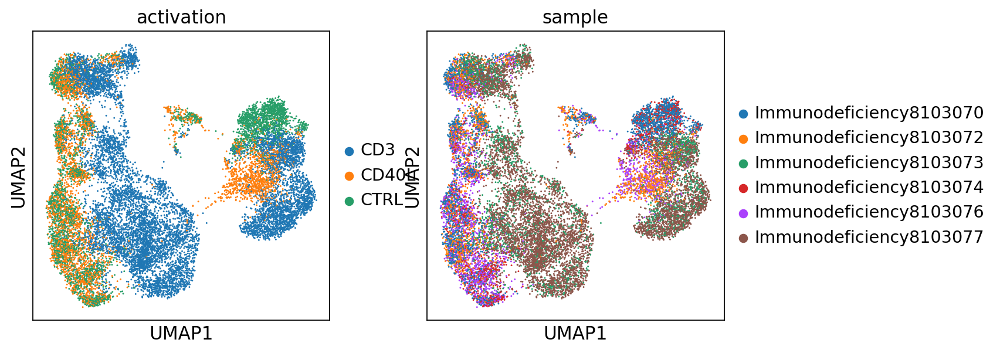

In [10]:
sc.pl.umap(adata, color=['activation','sample'])

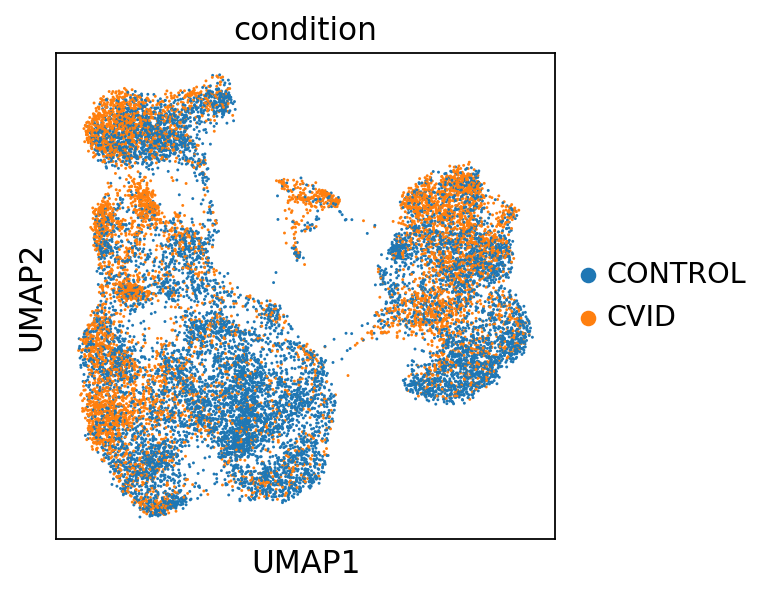

In [11]:
sc.pl.umap(adata, color=['condition'])

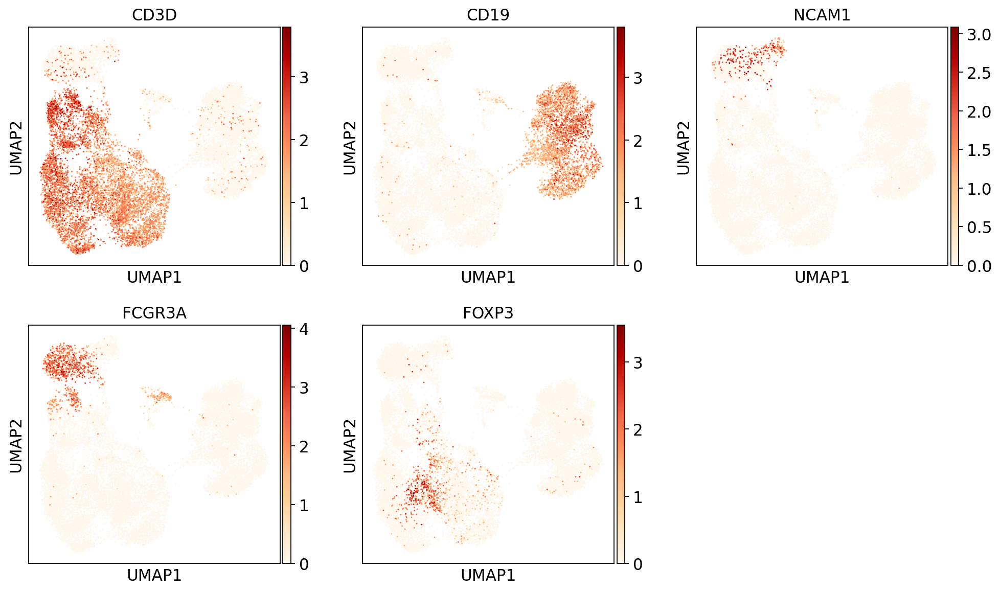

In [12]:
sc.pl.umap(adata, color=['CD3D', # T cells
                             'CD19', # B cells
                             # NK markers
                             'NCAM1', # CD56
                             'FCGR3A', # CD16
                             'FOXP3', # T_regs
                            ], ncols=3, use_raw=True, cmap='OrRd')

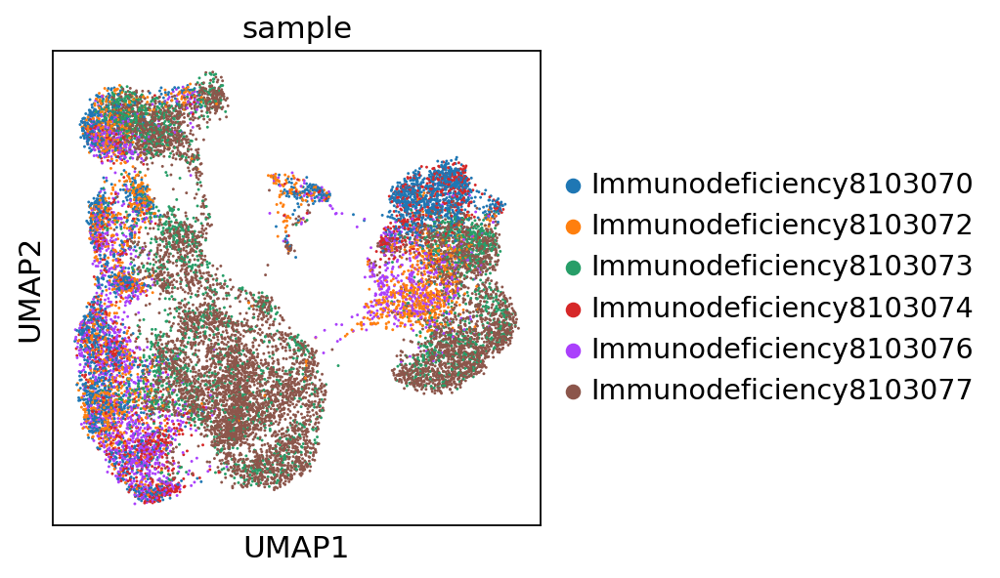

In [12]:
sc.pl.umap(adata, color=['sample'])

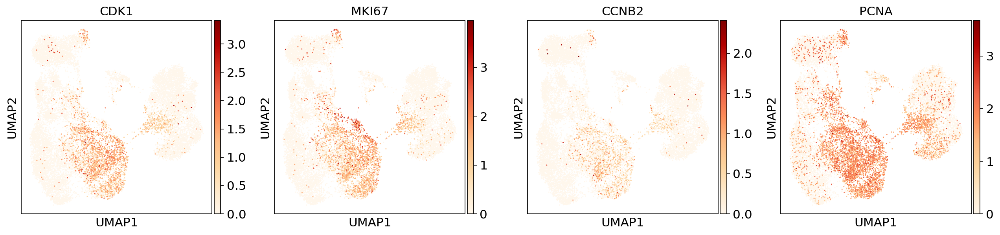

In [13]:
sc.pl.umap(adata, color=['CDK1','MKI67','CCNB2','PCNA'], cmap='OrRd')

In [14]:
adata

AnnData object with n_obs × n_vars = 17315 × 2439
    obs: 'activation', 'barcode_sample', 'batch', 'bh_pval', 'condition', 'n_counts', 'n_genes', 'percent_mito', 'sample', 'scrublet_cluster_score', 'scrublet_score', 'technique', 'is_doublet', 'S_score', 'G2M_score', 'phase', 'probabilities', 'celltype_predictions', 'louvain', 'louvain_R_1_3', 'cell_type', 'barcode'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_ids-5', 'feature_types-5', 'genome-5', 'n_cells-5', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'activation_colors', 'ccgs', 'cell_type_colors', 'celltype_predictions_colors', 'condition_colors', 'louvain', 'louvain_R_1_3_colors', 'louvain_colors', 'neighbors', 'pca', 'phase_colors', 'sample_colors

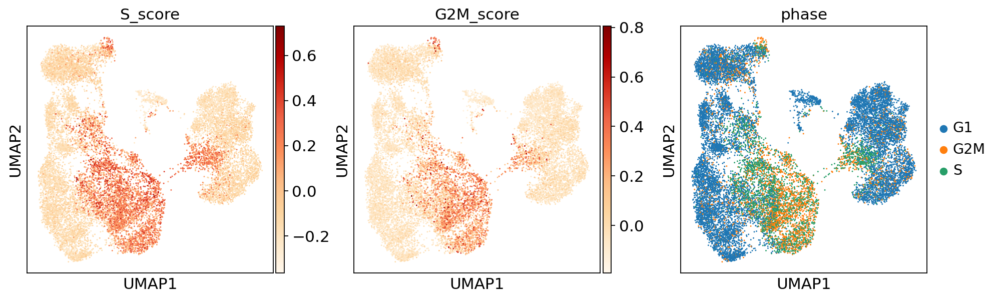

In [15]:
sc.pl.umap(adata, color=['S_score','G2M_score','phase'], cmap='OrRd')

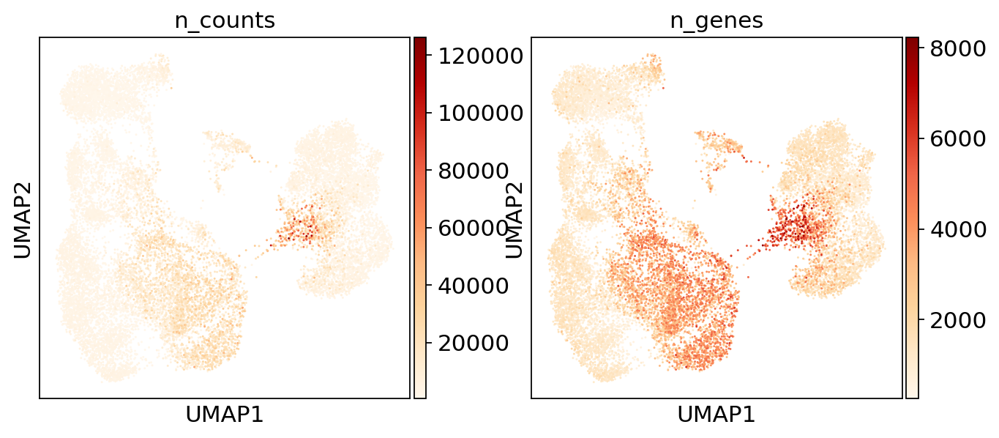

In [16]:
sc.pl.umap(adata, color=['n_counts',
                             'n_genes'], cmap='OrRd')

# Annotation

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 9 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:01)


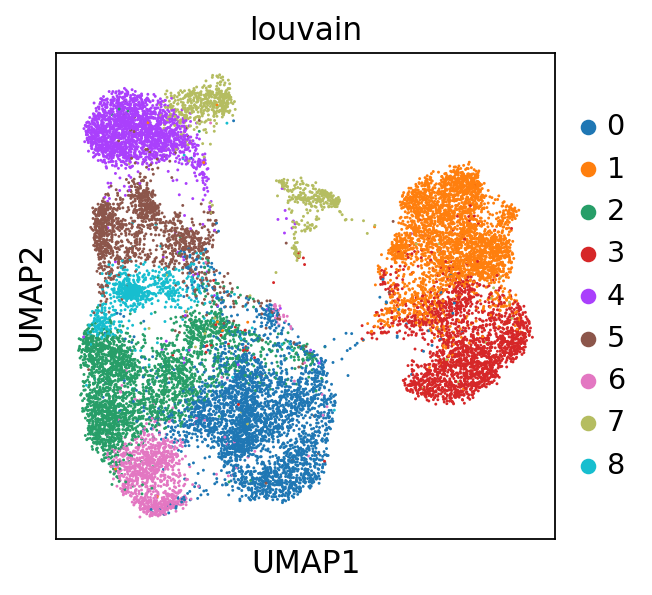

In [14]:
sc.tl.louvain(adata, resolution=1.0)
sc.pl.umap(adata, color=['louvain'])

In [15]:
adata.obs['louvain'] = adata.obs['louvain'].astype(str)

... storing 'louvain' as categorical


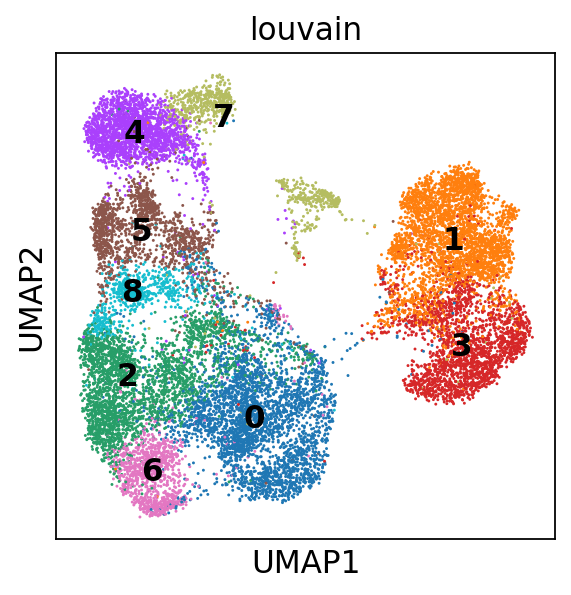

In [16]:
sc.pl.umap(adata, color=['louvain'], legend_loc='on data')

In [17]:
default_louvain_colors = adata.uns['louvain_colors']
default_louvain_colors

array(['#1f77b4', '#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b',
       '#e377c2', '#b5bd61', '#17becf'], dtype=object)

Clusters to zoom in on:
- 7
- 4
- 5
- 8
- 2
- 0
- 6

In [18]:
# zoom into cluster 7
sc.tl.louvain(adata, restrict_to=('louvain',['7']),
             key_added='louvain_R_7',
             resolution=0.4)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 10 clusters and added
    'louvain_R_7', the cluster labels (adata.obs, categorical) (0:00:00)


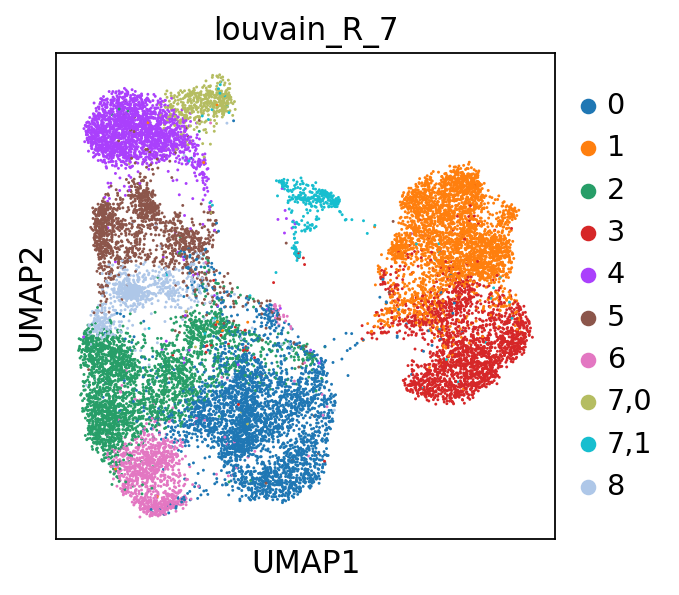

In [19]:
sc.pl.umap(adata, color=['louvain_R_7'])

In [20]:
# zoom into cluster 7,0
sc.tl.louvain(adata, restrict_to=('louvain_R_7',['7,0']),
             key_added='louvain_R_7,0',
             resolution=0.6)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 11 clusters and added
    'louvain_R_7,0', the cluster labels (adata.obs, categorical) (0:00:00)


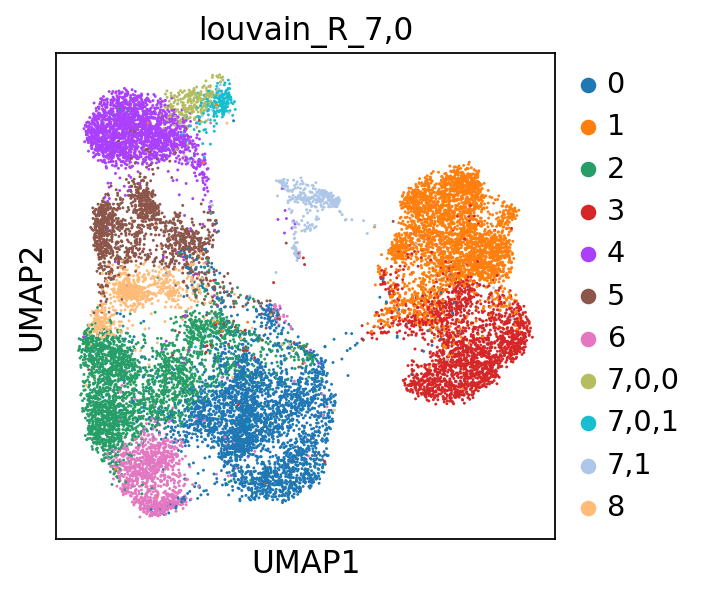

In [21]:
sc.pl.umap(adata, color=['louvain_R_7,0'])

In [22]:
# 7 --> louvain_R_7,0

# 7,0,0 - NK_CD56+
# 7,0,1 - NK_CD56+_activated
# 7,1 - Myeloid_cells

In [23]:
# cluster 4
sc.tl.louvain(adata, restrict_to=('louvain',['4']),
             key_added='louvain_R_4',
             resolution=0.8)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 13 clusters and added
    'louvain_R_4', the cluster labels (adata.obs, categorical) (0:00:00)


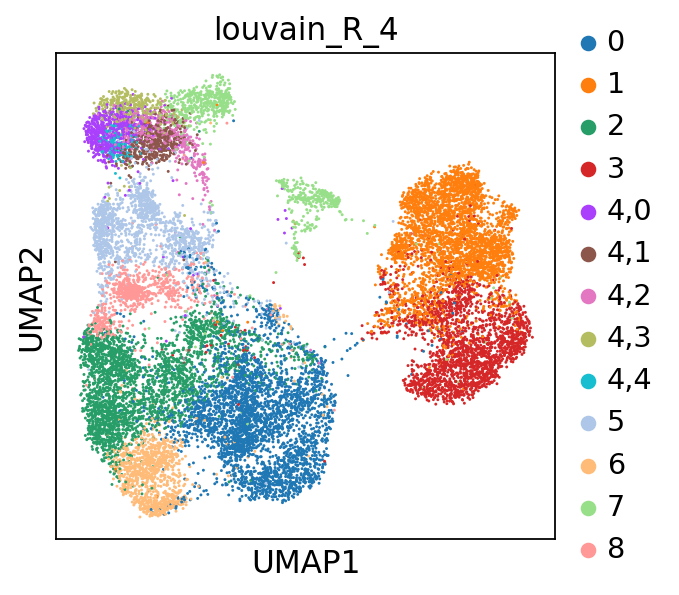

In [24]:
sc.pl.umap(adata, color=['louvain_R_4'])

In [25]:
# 4

# 4,0; 4,4 - NK_CD16+
# 4,1; 4,2; 4,3 - NK_CD16+_activated

In [26]:
# zoom into cluster 5
sc.tl.louvain(adata, restrict_to=('louvain',['5']),
             key_added='louvain_R_5',
             resolution=0.9)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 14 clusters and added
    'louvain_R_5', the cluster labels (adata.obs, categorical) (0:00:00)


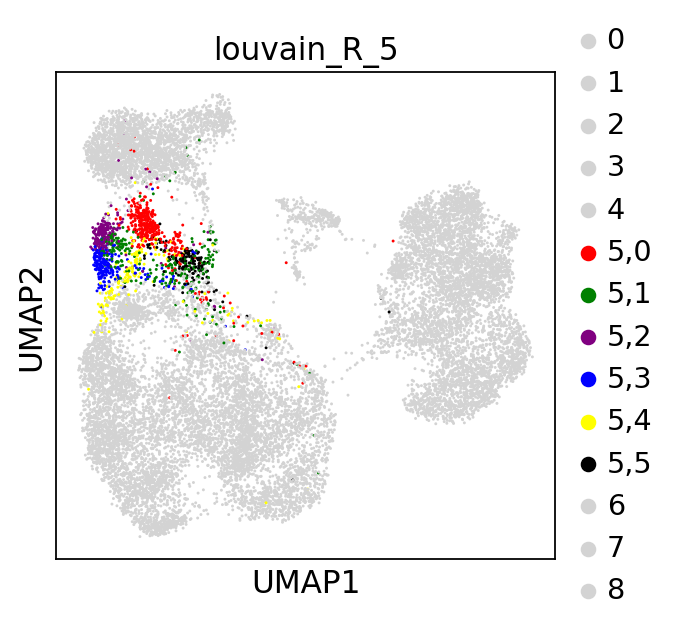

In [27]:
sc.pl.umap(adata, color=['louvain_R_5'],
          palette=['lightgrey']*5 + ['red','green','purple','blue','yellow','black'] + ['lightgrey']*3)


In [28]:
# 5

# 5,1; 5,2; 5,3 - T_gd
# 5,0; 5,4 - T8_memory
# 5,5 - T8_activated_2

In [29]:
# zoom into cluster 8
sc.tl.louvain(adata, restrict_to=('louvain',['8']),
             key_added='louvain_R_8',
             resolution=0.7)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 11 clusters and added
    'louvain_R_8', the cluster labels (adata.obs, categorical) (0:00:00)


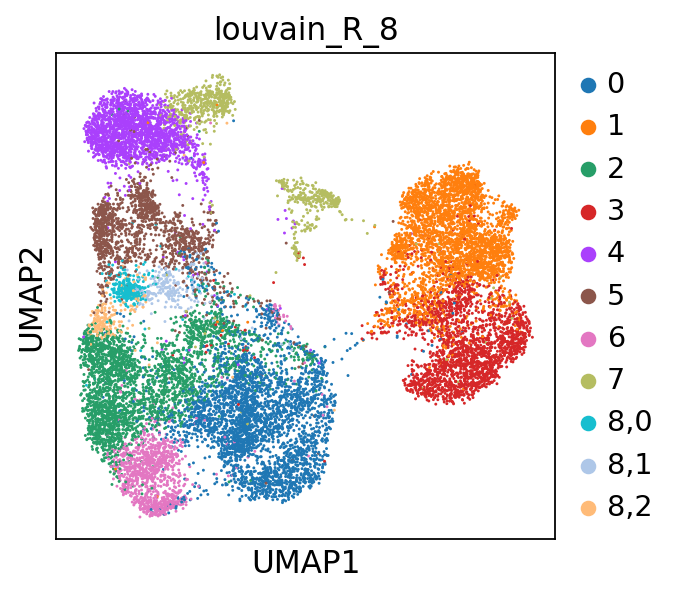

In [30]:
sc.pl.umap(adata, color=['louvain_R_8'])

In [31]:
# 8

# 8,0 - MAIT_cells
# 8,1 - MAIT_cells_activated
# 8,2 - T4_memory

In [32]:
# zoom into cluster 2
sc.tl.louvain(adata, restrict_to=('louvain',['2']),
             key_added='louvain_R_2',
             resolution=0.6)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 12 clusters and added
    'louvain_R_2', the cluster labels (adata.obs, categorical) (0:00:00)


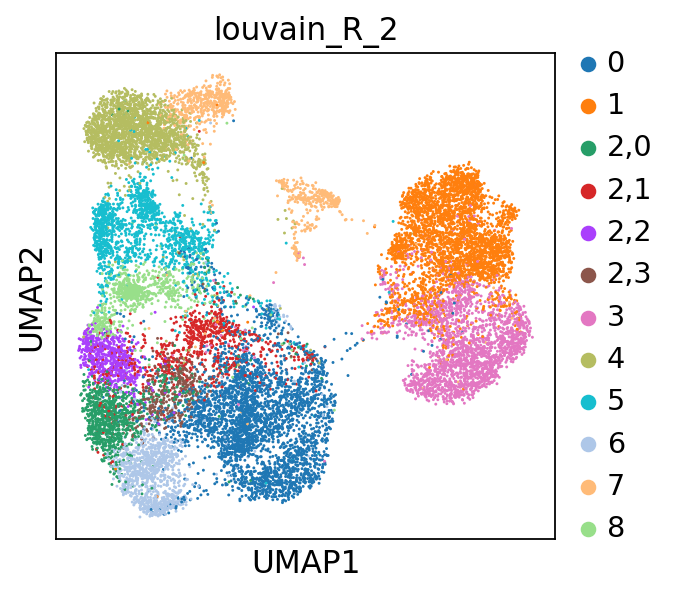

In [33]:
sc.pl.umap(adata, color=['louvain_R_2'])

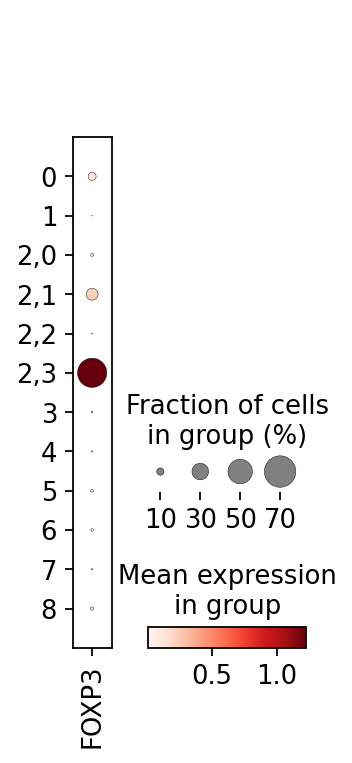

In [42]:
sc.pl.dotplot(adata, groupby='louvain_R_2',
             var_names = 'FOXP3', use_raw=True)

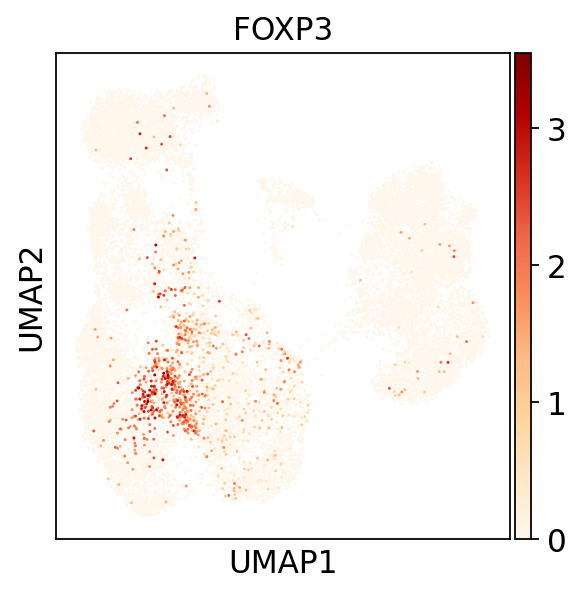

In [34]:
sc.pl.umap(adata, color=['FOXP3'], cmap='OrRd', use_raw=True)

In [35]:
# zoom into cluster 2,1
# found 14 clusters
sc.tl.louvain(adata, restrict_to=('louvain_R_2',['2,1']),
             key_added='louvain_R_2,1',
             resolution=0.6)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 14 clusters and added
    'louvain_R_2,1', the cluster labels (adata.obs, categorical) (0:00:00)


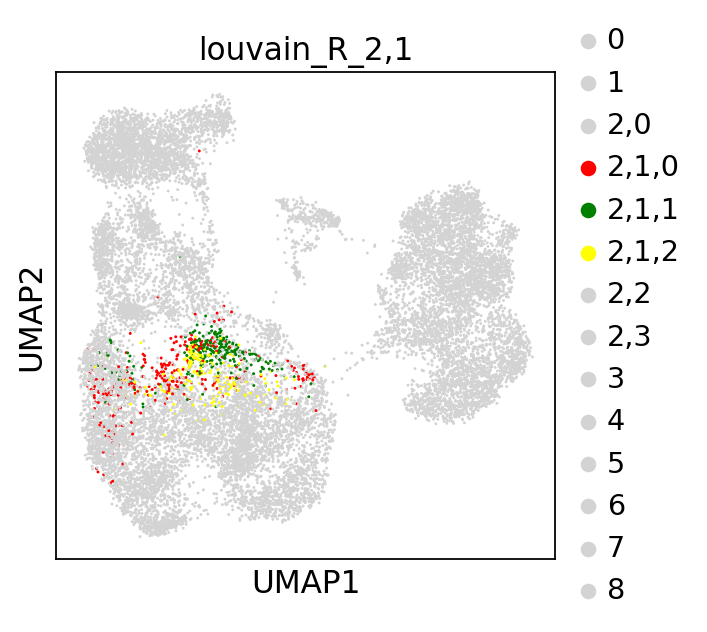

In [36]:
sc.pl.umap(adata, color=['louvain_R_2,1'],
                     palette=['lightgrey']*3 + ['red','green','yellow'] + ['lightgrey']*8)


In [43]:
# NEW:
# 2 --> louvain_R_2
# 2,0; 2,2 - T4_memory
# 2,3 - Tregs
# 2,1 - T4_activated

# OLD
# 2 --> louvain_R_2,1
# 2,0; 2,2 - T4_memory
# 2,3; 2,1,0 - Tregs
# 2,1,1; 2,1,2 - T4_activated

In [44]:
# zoom into cluster 0
sc.tl.louvain(adata, restrict_to=('louvain',['0']),
             key_added='louvain_R_0',
             resolution=0.8)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 14 clusters and added
    'louvain_R_0', the cluster labels (adata.obs, categorical) (0:00:00)


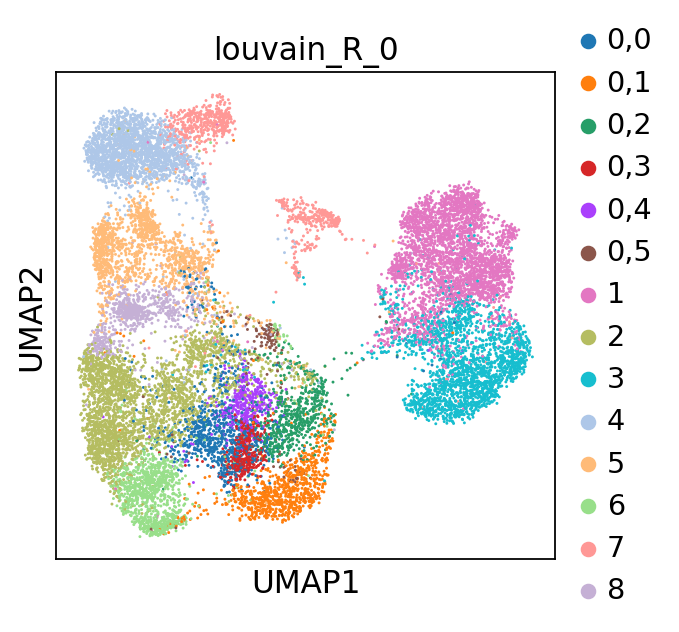

In [45]:
sc.pl.umap(adata, color=['louvain_R_0'])

In [46]:
# 0

# NEW
# 0,1 - T8_activated_1
# 0,0; 0,2; 0,3; 0,4 - T4_activated
# 0,5 - T8_activated_2

# OLD:
# 0,0 - Tregs
# 0,1 - T8_activated_1
# 0,2; 0,3; 0,4 - T4_activated
# 0,5 - T8_activated_2

In [47]:
# zoom into cluster 6
sc.tl.louvain(adata, restrict_to=('louvain',['6']),
             key_added='louvain_R_6',
             resolution=0.8)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 11 clusters and added
    'louvain_R_6', the cluster labels (adata.obs, categorical) (0:00:00)


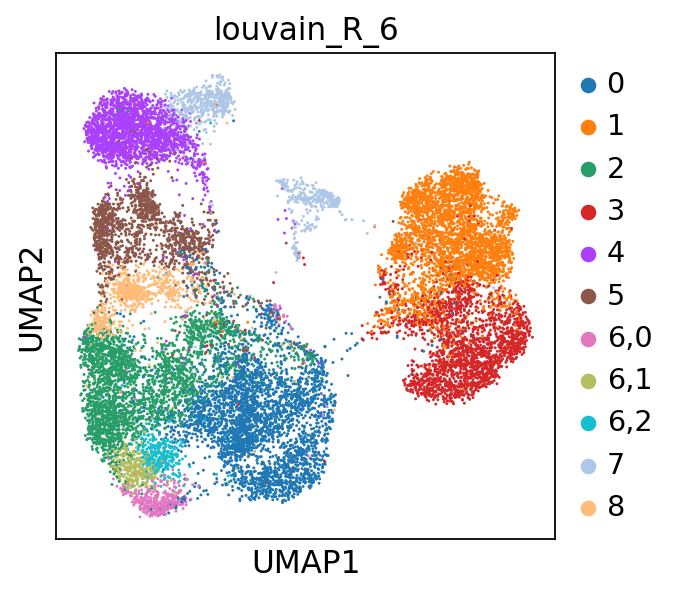

In [48]:
sc.pl.umap(adata, color=['louvain_R_6'])

In [49]:
# 6

# 6,0 - T8_naive
# 6,1; 6,2 - T4_naive

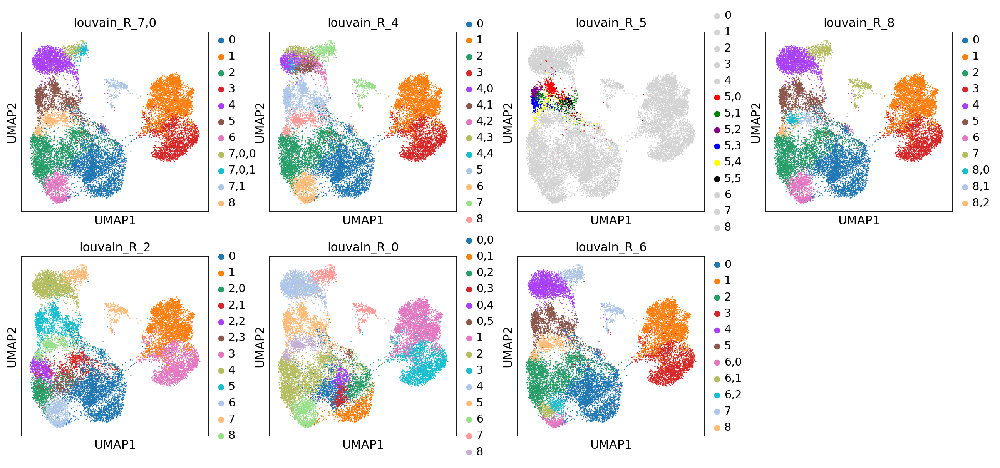

In [50]:
sc.pl.umap(adata, color=['louvain_R_7,0','louvain_R_4','louvain_R_5','louvain_R_8','louvain_R_2','louvain_R_0','louvain_R_6'])

# Labelling

Clusters to zoom in on:
- 7
- 4
- 5
- 8
- 2
- 0
- 6

In [51]:
def annot_prelim(adata_obj, barcode):
    
    # coarse louvain labels
    
    curr_louvain_coarse = adata_obj.obs.loc[barcode,'louvain']
    
    
    if curr_louvain_coarse == '7':
        zoomed_in_louvain = adata_obj.obs.loc[barcode,'louvain_R_7,0']
        # 7 --> louvain_R_7,0

        # 7,0,0 - NK_CD56+
        # 7,0,1 - NK_CD56+_activated
        # 7,1 - Myeloid_cells
        if zoomed_in_louvain == '7,0,0':
            return('NK_CD56_bright')
        elif zoomed_in_louvain == '7,0,1':
            return('NK_CD56_bright_activated')
        elif zoomed_in_louvain == '7,1':
            return('Myeloid_cells')
        else:
            return('not_assigned_R_7,0')
        
    elif curr_louvain_coarse == '4':
        # 4

        # 4,0; 4,4 - NK_CD16+
        # 4,1; 4,2; 4,3 - NK_CD16+_activated
        zoomed_in_louvain = adata_obj.obs.loc[barcode,'louvain_R_4']
        if zoomed_in_louvain in ['4,0','4,4']:
            return('NK_CD16_bright')
        elif zoomed_in_louvain in ['4,1','4,2','4,3']:
            return('NK_CD16_bright_activated')
        else:
            return('not_assigned_R_4')
        

    elif curr_louvain_coarse == '5':
        # 5

        # 5,1; 5,2; 5,3 - T_gd
        # 5,0; 5,4 - T8_memory
        # 5,5 - T8_activated_2
        
        zoomed_in_louvain = adata_obj.obs.loc[barcode,'louvain_R_5']
        if zoomed_in_louvain in ['5,2','5,1','5,3']:
            return('T_gd')
        elif zoomed_in_louvain in ['5,0','5,4']:
            return('T8_memory')
        elif zoomed_in_louvain == '5,5':
            return('T8_activated_2')
        else:
            return('not_assigned_R_5')
        
        
    elif curr_louvain_coarse == '8':
        # 8

        # 8,0 - MAIT_cells
        # 8,1 - MAIT_cells_activated
        # 8,2 - T4_memory
        
        zoomed_in_louvain = adata_obj.obs.loc[barcode,'louvain_R_8']
        if zoomed_in_louvain == '8,0':
            return('MAIT_cells')
        elif zoomed_in_louvain == '8,1':
            return('MAIT_cells_activated')
        elif zoomed_in_louvain == '8,2':
            return('T4_memory')
        else:
            return('not_assigned_R_8')
        
    elif curr_louvain_coarse == '2':
        # 2 --> louvain_R_2

        # 2,0; 2,2 - T4_memory
        # 2,3 - Tregs
        # 2,1 - T4_activated
        
        zoomed_in_louvain = adata_obj.obs.loc[barcode,'louvain_R_2']
        if zoomed_in_louvain in ['2,0','2,2']:
            return('T4_memory')
        elif zoomed_in_louvain == '2,3':
            return('T_regs')
        elif zoomed_in_louvain == '2,1':
            return('T4_activated')
        else:
            return('not_assigned_R_2')
        
        
        
    elif curr_louvain_coarse == '0':
        # 0

        # 0,1 - T8_activated_1
        # 0,0; 0,2; 0,3; 0,4 - T4_activated
        # 0,5 - T8_activated_2

        zoomed_in_louvain = adata_obj.obs.loc[barcode,'louvain_R_0']
        if zoomed_in_louvain in ['0,0','0,2', '0,3', '0,4']:
            return('T4_activated')
        elif zoomed_in_louvain == '0,1':
            return('T8_activated_1')
        elif zoomed_in_louvain == '0,5':
            return('T8_activated_2')
        else:
            return('not_assigned_R_0')
        
        
    elif curr_louvain_coarse == '6':
        # 6
        
        # 6,0 - T8_naive
        # 6,1; 6,2 - T4_naive
        
        zoomed_in_louvain = adata_obj.obs.loc[barcode,'louvain_R_6']
        if zoomed_in_louvain == '6,0':
            return('T8_naive')
        elif zoomed_in_louvain in ['6,1','6,2']:
            return('T4_naive')
        else:
            return('not_assigned_R_6')
        
        
    elif curr_louvain_coarse in ['1','3']:
        
        return('B_cells')
    
    
    else:
        return('not_assigned')
    

In [52]:
adata.obs['barcode'] = adata.obs.index

In [53]:
adata.obs['cell_type'] = adata.obs['barcode'].apply(lambda x: annot_prelim(adata,x))

... storing 'cell_type' as categorical


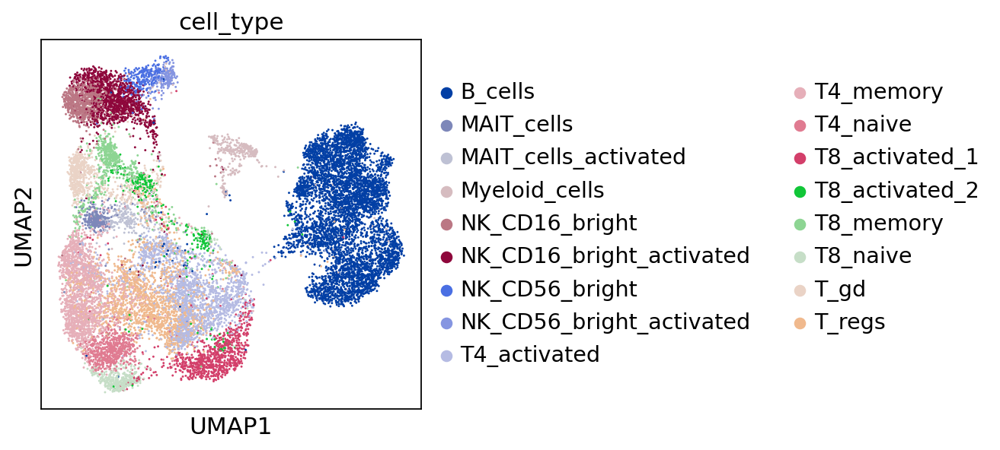

In [54]:
# OLD
sc.pl.umap(adata, color='cell_type')

... storing 'cell_type' as categorical


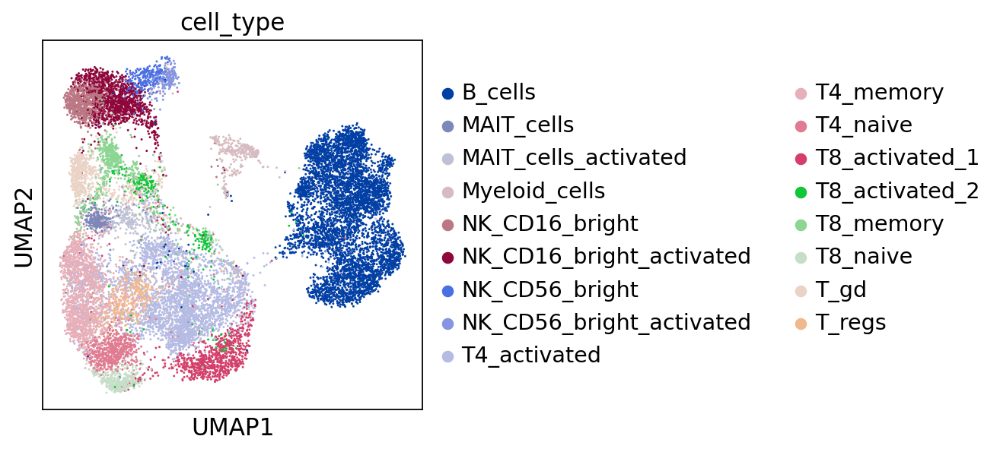

In [54]:
# NEW
sc.pl.umap(adata, color='cell_type')

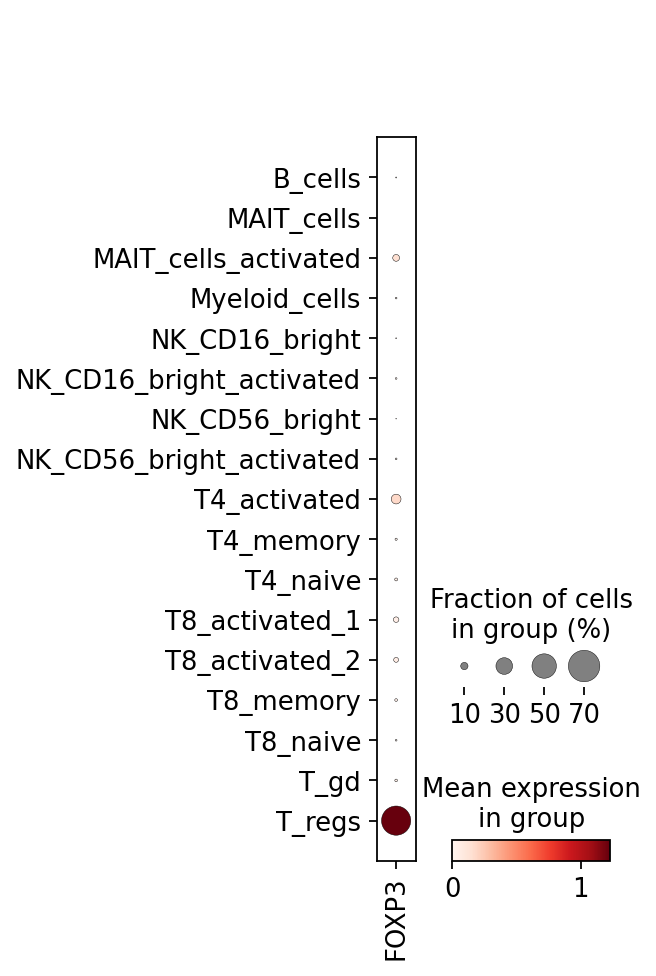

In [55]:
sc.pl.dotplot(adata, groupby='cell_type',
             var_names = 'FOXP3', use_raw=True)

In [56]:
# adding predictions of Naive/memory B cells here - from Hamish's data and our SS2, and also the GC predictions
predictions_GC = pd.read_csv(save_path + 'table_predictions_GC_B_cells_20210209.csv', index_col=0)
predictions_N_USM_SM_SS2 = pd.read_csv(save_path + 'table_predictions_N_USM_SM_B_cells_from_SS2_20210209.csv', index_col=0)
predictions_naive_memory_Hamish = pd.read_csv(save_path + 'table_predictions_naive_memory_B_cells_from_Hamish_B_cells_20210209.csv', index_col=0)

In [57]:
predictions_GC

,GC_celltype_predictions_all_genes,probabilities_GC_all_genes
index,,
TCAGGATCAGTTTACG-1,GC_B_cells,0.923887
GATCGCGTCCTACAGA-1,Other_B_cells,0.894088
CGATCGGCACGGCCAT-1,Other_B_cells,0.867857
CTGCGGATCGTTACAG-1,Other_B_cells,0.922326
CATGACACAACCGCCA-1,Other_B_cells,0.862777
...,...,...
CGGCTAGAGGACTGGT-1,GC_B_cells,0.604539
CGACCTTAGTCAAGCG-1,Other_B_cells,0.776154
TTAGGACGTTCGTCTC-1,Other_B_cells,0.593919


In [58]:
predictions_N_USM_SM_SS2

,celltype_predictions_all_genes_from_SS2,probabilities_from_SS2_all_genes
index,,
TCAGGATCAGTTTACG-1,SM,0.507073
GATCGCGTCCTACAGA-1,USM,0.499629
CGATCGGCACGGCCAT-1,N,0.912532
CTGCGGATCGTTACAG-1,SM,0.425460
CATGACACAACCGCCA-1,N,0.661926
...,...,...
CGGCTAGAGGACTGGT-1,SM,0.686876
CGACCTTAGTCAAGCG-1,USM,0.800904
TTAGGACGTTCGTCTC-1,N,0.916579


In [59]:
predictions_naive_memory_Hamish

,naive_memory_predictions_Hamish_all_genes,probabilities_naive_memory_predictions_Hamish_all_genes
index,,
TCAGGATCAGTTTACG-1,MBC,0.997149
GATCGCGTCCTACAGA-1,MBC,0.547759
CGATCGGCACGGCCAT-1,MBC,0.962039
CTGCGGATCGTTACAG-1,MBC,1.000000
CATGACACAACCGCCA-1,MBC,0.993235
...,...,...
CGGCTAGAGGACTGGT-1,Naive,0.577116
CGACCTTAGTCAAGCG-1,MBC,0.638730
TTAGGACGTTCGTCTC-1,MBC,0.998638


In [60]:
adata.obs['GC_celltype_predictions'] = [predictions_GC.loc[barcode, 'GC_celltype_predictions_all_genes'] if barcode in predictions_GC.index else 'none' for barcode in adata.obs_names]
adata.obs['GC_celltype_prediction_probabilities'] = [predictions_GC.loc[barcode, 'probabilities_GC_all_genes'] if barcode in predictions_GC.index else 0 for barcode in adata.obs_names]
#adata.obs['GC_celltype_prediction_probabilities'] = adata.obs['GC_celltype_prediction_probabilities'].astype(float)

adata.obs['N_USM_SM_predictions'] = [predictions_N_USM_SM_SS2.loc[barcode, 'celltype_predictions_all_genes_from_SS2'] if barcode in predictions_N_USM_SM_SS2.index else 'none' for barcode in adata.obs_names]
adata.obs['N_USM_SM_prediction_probabilities'] = [predictions_N_USM_SM_SS2.loc[barcode, 'probabilities_from_SS2_all_genes'] if barcode in predictions_N_USM_SM_SS2.index else 0 for barcode in adata.obs_names]
#adata.obs['N_USM_SM_prediction_probabilities'] = adata.obs['N_USM_SM_prediction_probabilities'].astype(float)


adata.obs['naive_memory_predictions_Hamish'] = [predictions_naive_memory_Hamish.loc[barcode, 'naive_memory_predictions_Hamish_all_genes'] if barcode in predictions_naive_memory_Hamish.index else 'none' for barcode in adata.obs_names]
adata.obs['naive_memory_predictions_Hamish_probabilities'] = [predictions_naive_memory_Hamish.loc[barcode, 'probabilities_naive_memory_predictions_Hamish_all_genes'] if barcode in predictions_naive_memory_Hamish.index else 0 for barcode in adata.obs_names]
#adata.obs['naive_memory_predictions_Hamish_probabilities'] = adata.obs['naive_memory_predictions_Hamish_probabilities'].astype(float)

... storing 'GC_celltype_predictions' as categorical
... storing 'N_USM_SM_predictions' as categorical
... storing 'naive_memory_predictions_Hamish' as categorical


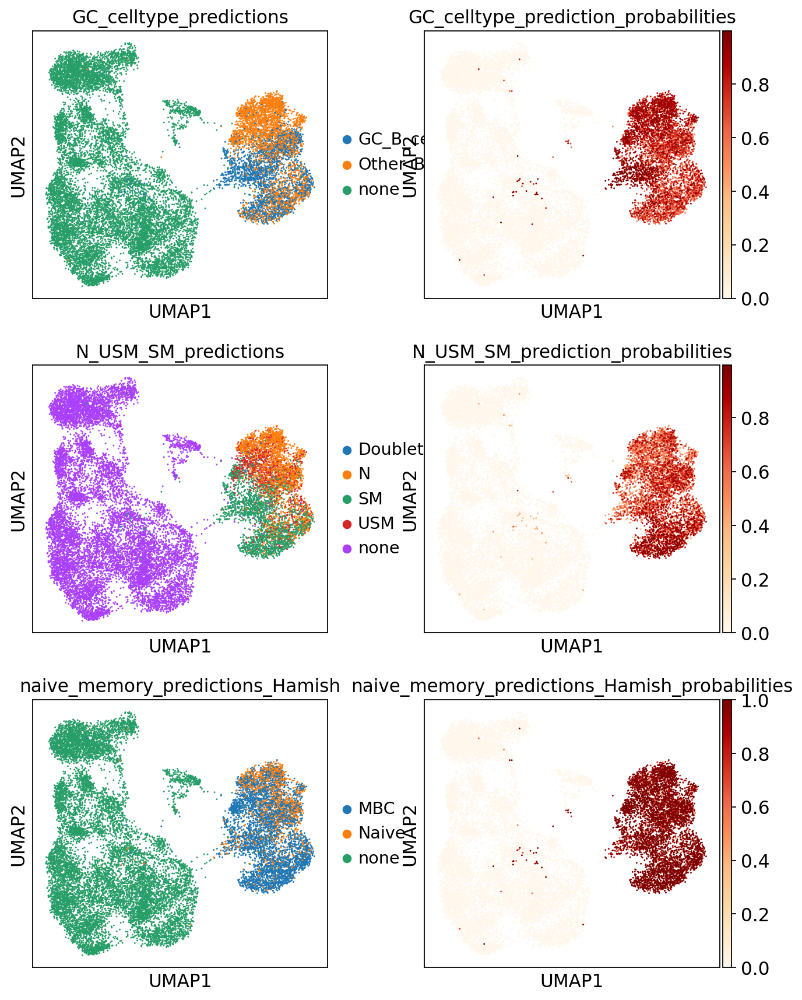

In [61]:
sc.pl.umap(adata, color = ['GC_celltype_predictions', 'GC_celltype_prediction_probabilities',
                           'N_USM_SM_predictions', 'N_USM_SM_prediction_probabilities',
                           'naive_memory_predictions_Hamish', 'naive_memory_predictions_Hamish_probabilities'
                          ],
          cmap='OrRd', ncols=2)

In [62]:
# zoom in clustering of B cells
sc.tl.louvain(adata, resolution=1.0, restrict_to = ('louvain',['1','3']),
             key_added='louvain_R_1_3')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 15 clusters and added
    'louvain_R_1_3', the cluster labels (adata.obs, categorical) (0:00:00)


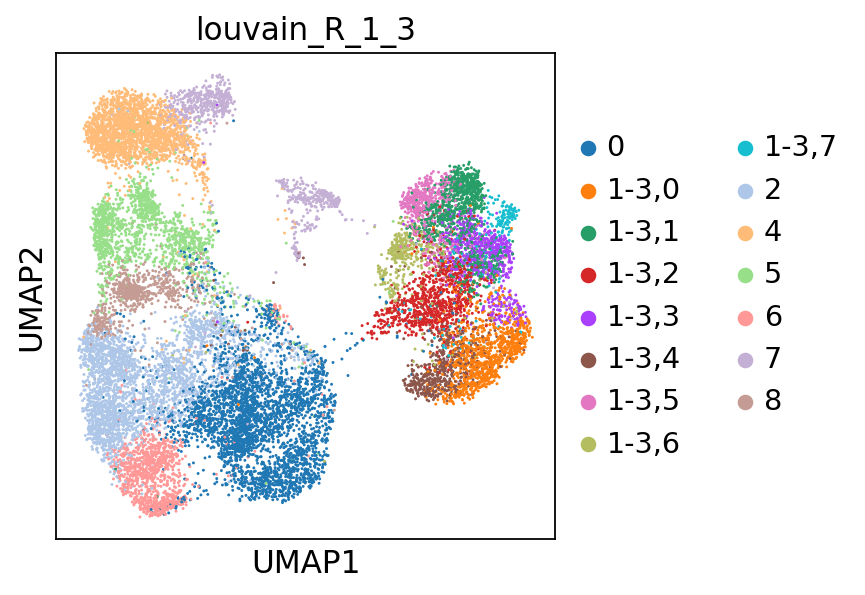

In [63]:
sc.pl.umap(adata, color=['louvain_R_1_3'])

In [64]:
# 1-3,0; 1-3,4; 1-3,2 - B_cells_memory_activated
# 1-3,6 - B_cells_memory
# 1-3,1; 1-3,5 - B_cells_naive
# 1-3,3 - B_cells_naive_activated
# 1-3,7 - B_cells_oligoclonal

In [65]:
# prioritisiing T:B_doublets
def add_B_cell_annotation(adata_obj, barcode):
    
    curr_louvain = adata_obj.obs.loc[barcode,'louvain']
    
    if curr_louvain in ['1','3']:
        # 0,0 - Tregs
        # 0,1 - T8_activated_1
        # 0,2; 0,3; 0,4 - T4_activated
        # 0,5 - T8_activated_2
        zoomed_in_louvain = adata_obj.obs.loc[barcode,'louvain_R_1_3']
        if zoomed_in_louvain in ['1-3,0','1-3,4','1-3,2']:
            return('B_cells_memory_activated')
        elif zoomed_in_louvain == '1-3,6':
            return('B_cells_memory')
        elif zoomed_in_louvain in ['1-3,1','1-3,5']:
            return('B_cells_naive')
        elif zoomed_in_louvain == '1-3,3':
            return('B_cells_naive_activated')
        elif zoomed_in_louvain == '1-3,7':
            return('B_cells_oligoclonal')
        else:
            return('not_assigned_B_cells')
        
    else:
        return(adata_obj.obs.loc[barcode,'cell_type'])

In [66]:
adata.obs['barcode'] = adata.obs.index

In [67]:
adata.obs['cell_type'] = adata.obs['barcode'].apply(lambda x: add_B_cell_annotation(adata, x))

### On top of the annotation (at the end), adding annotation of B:T doublets by BCR data (see VDJ notebooks)

In [68]:
# reading doublets by BCR table
doublets_by_BCR = pd.read_csv(save_path + 'doublets_by_BCR_table_twins_20210212.csv', index_col=0)
np.unique(doublets_by_BCR['doublets_by_BCR'], return_counts=True)

(array([False,  True]), array([17105,   210]))

In [69]:
len(set(doublets_by_BCR.index) & set(adata.obs_names))

17315

In [70]:
adata

AnnData object with n_obs × n_vars = 17315 × 2439
    obs: 'activation', 'barcode_sample', 'batch', 'bh_pval', 'condition', 'n_counts', 'n_genes', 'percent_mito', 'sample', 'scrublet_cluster_score', 'scrublet_score', 'technique', 'is_doublet', 'S_score', 'G2M_score', 'phase', 'probabilities', 'celltype_predictions', 'louvain', 'louvain_R_1_3', 'cell_type', 'barcode', 'louvain_R_7', 'louvain_R_7,0', 'louvain_R_4', 'louvain_R_5', 'louvain_R_8', 'louvain_R_2', 'louvain_R_2,1', 'louvain_R_0', 'louvain_R_6', 'GC_celltype_predictions', 'GC_celltype_prediction_probabilities', 'N_USM_SM_predictions', 'N_USM_SM_prediction_probabilities', 'naive_memory_predictions_Hamish', 'naive_memory_predictions_Hamish_probabilities', 'louvain_R_2,0'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature

In [71]:
adata.obs_names

Index(['TCAGGATCAGTTTACG-1', 'GATCGCGTCCTACAGA-1', 'CTTGGCTCATTATCTC-1',
       'TGTATTCGTACGCTGC-1', 'GTGTTAGGTCCGCTGA-1', 'CGATCGGCACGGCCAT-1',
       'CCACCTATCCTGTACC-1', 'CTGCGGATCGTTACAG-1', 'CATGACACAACCGCCA-1',
       'CTGGTCTTCAATCACG-1',
       ...
       'CGGCTAGAGGACTGGT-1', 'GTCTTCGGTCTACCTC-1', 'GTTAAGCAGCGTAGTG-1',
       'TAAGCGTTCTAGAGTC-1', 'CGACCTTAGTCAAGCG-1', 'TTAGGACGTTCGTCTC-1',
       'GCGCAGTAGCCTCGTG-1', 'AAGACCTCAAGTAGTA-1', 'TATTACCTCACCCGAG-1',
       'CCTTCCCCAACTGCTA-1'],
      dtype='object', name='index', length=17315)

In [72]:
type(doublets_by_BCR.loc['TCAGGATCAGTTTACG-1', 'doublets_by_BCR'])

numpy.bool_

In [73]:
def add_doublets_by_BCR(adata_obj, barcode):
    
    curr_doublet_value = doublets_by_BCR.loc[barcode, 'doublets_by_BCR']
    
    if curr_doublet_value == True:
        return('B:T_doublets_by_BCR')
    elif curr_doublet_value == False:
        return(adata_obj.obs.loc[barcode, 'cell_type'])
    

In [74]:
adata.obs['cell_type'] = adata.obs['barcode'].apply(lambda x: add_doublets_by_BCR(adata,x))

... storing 'cell_type' as categorical


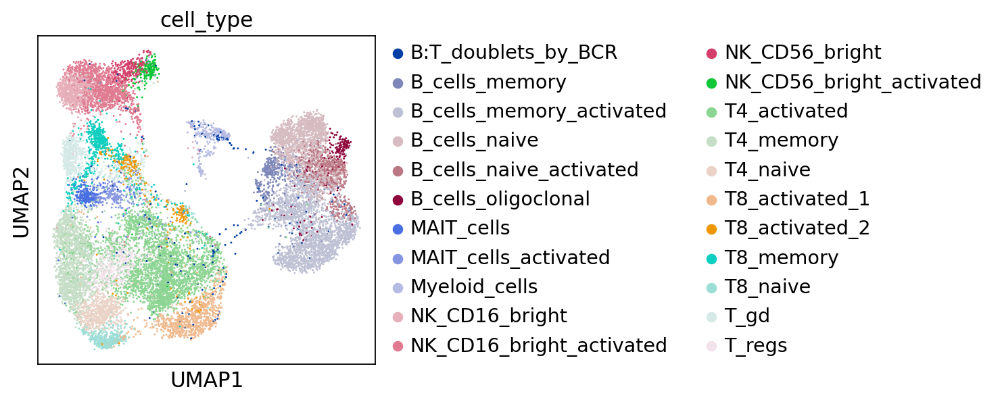

In [75]:
sc.pl.umap(adata, color='cell_type')

# ANNOTATION

In [76]:
# saving this annotation into a table
#adata.obs.loc[:,['cell_type']].to_csv(save_path + 'general_annotation_20210212.csv')

# NEW, corrected T4_act and T_regs compartments
adata.obs.loc[:,['cell_type']].to_csv(save_path + 'general_annotation_20210308.csv')

In [81]:
save_path

'/lustre/scratch117/cellgen/team292/aa22/adata_objects/202009_CVID_revision/202102_twins_reanalysis/'

In [77]:
adata.write(save_path + 'adata_hvg_bbknn_by_sample_nodoublets_20_PCs.h5ad')

In [78]:
np.unique(adata.obs['cell_type'], return_counts=True)

(array(['B:T_doublets_by_BCR', 'B_cells_memory',
        'B_cells_memory_activated', 'B_cells_naive',
        'B_cells_naive_activated', 'B_cells_oligoclonal', 'MAIT_cells',
        'MAIT_cells_activated', 'Myeloid_cells', 'NK_CD16_bright',
        'NK_CD16_bright_activated', 'NK_CD56_bright',
        'NK_CD56_bright_activated', 'T4_activated', 'T4_memory',
        'T4_naive', 'T8_activated_1', 'T8_activated_2', 'T8_memory',
        'T8_naive', 'T_gd', 'T_regs'], dtype=object),
 array([ 210,  391, 2472, 1568,  696,  196,  299,  219,  285,  763, 1235,
         238,  200, 2927, 1772,  675,  830,  288,  558,  408,  697,  388]))

In [79]:
annot_table = pd.read_csv(save_path + 'general_annotation_20210308.csv', index_col=0)
adata.obs['cell_type'] = annot_table.loc[adata.obs_names, 'cell_type']

... storing 'cell_type' as categorical


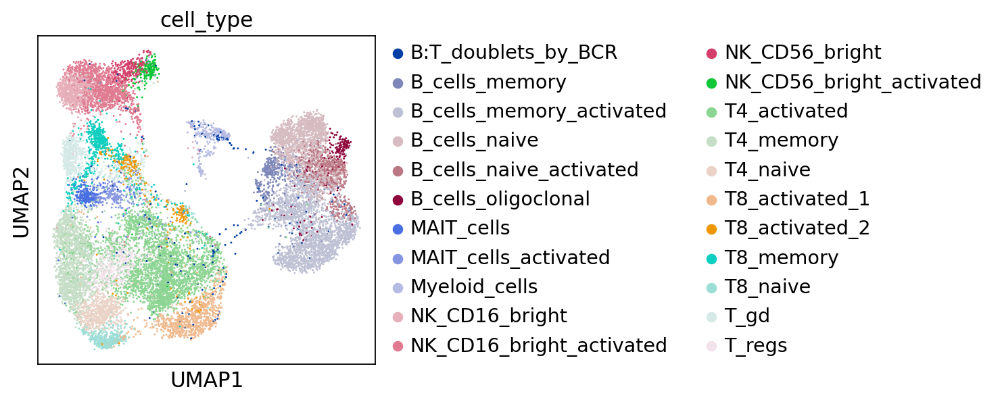

In [80]:
# NEW
sc.pl.umap(adata, color='cell_type')

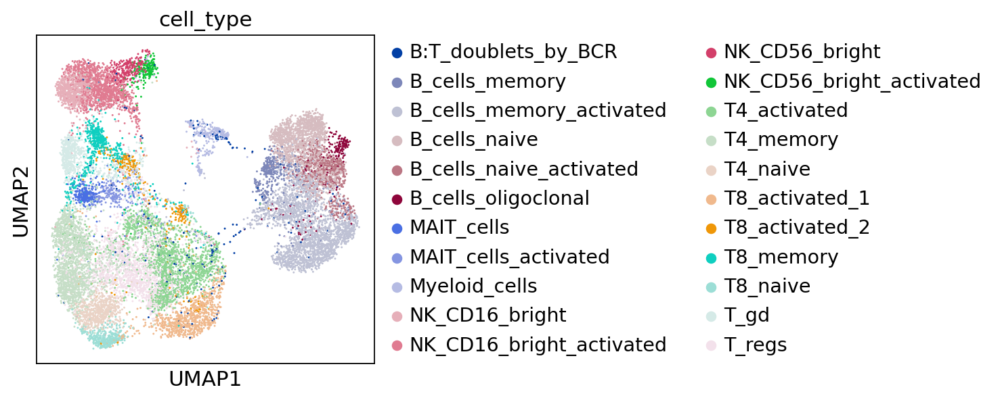

In [114]:
# OLD
sc.pl.umap(adata, color='cell_type')

# Correcting annotation of naive and activated naive B cells

In [12]:
# reading
adata = sc.read(save_path+'adata_hvg_bbknn_by_sample_nodoublets_20_PCs.h5ad')
adata

AnnData object with n_obs × n_vars = 17315 × 2439
    obs: 'activation', 'barcode_sample', 'batch', 'bh_pval', 'condition', 'n_counts', 'n_genes', 'percent_mito', 'sample', 'scrublet_cluster_score', 'scrublet_score', 'technique', 'is_doublet', 'S_score', 'G2M_score', 'phase', 'probabilities', 'celltype_predictions', 'louvain', 'louvain_R_1_3', 'cell_type', 'barcode', 'louvain_R_7', 'louvain_R_7,0', 'louvain_R_4', 'louvain_R_5', 'louvain_R_8', 'louvain_R_2', 'louvain_R_2,1', 'louvain_R_0', 'louvain_R_6', 'GC_celltype_predictions', 'GC_celltype_prediction_probabilities', 'N_USM_SM_predictions', 'N_USM_SM_prediction_probabilities', 'naive_memory_predictions_Hamish', 'naive_memory_predictions_Hamish_probabilities', 'louvain_R_2,0'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature

In [14]:
annot_table = pd.read_csv(save_path + 'general_annotation_20210308.csv', index_col=0)
adata.obs['cell_type_prev'] = annot_table.loc[adata.obs_names, 'cell_type']

... storing 'cell_type_prev' as categorical


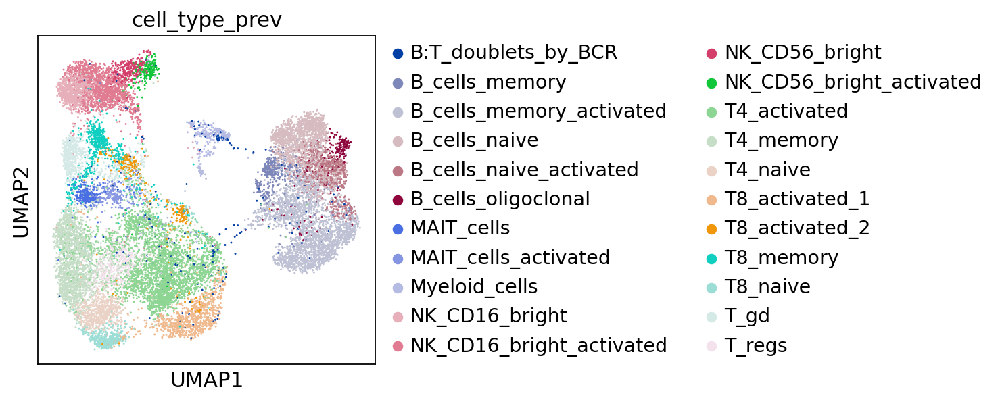

In [15]:
# after T_regs cluster correction
sc.pl.umap(adata, color='cell_type_prev')

In [16]:
# zoom in clustering of B cells
sc.tl.louvain(adata, resolution=1.0, restrict_to = ('louvain',['1','3']),
             key_added='louvain_R_1_3')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 15 clusters and added
    'louvain_R_1_3', the cluster labels (adata.obs, categorical) (0:00:00)


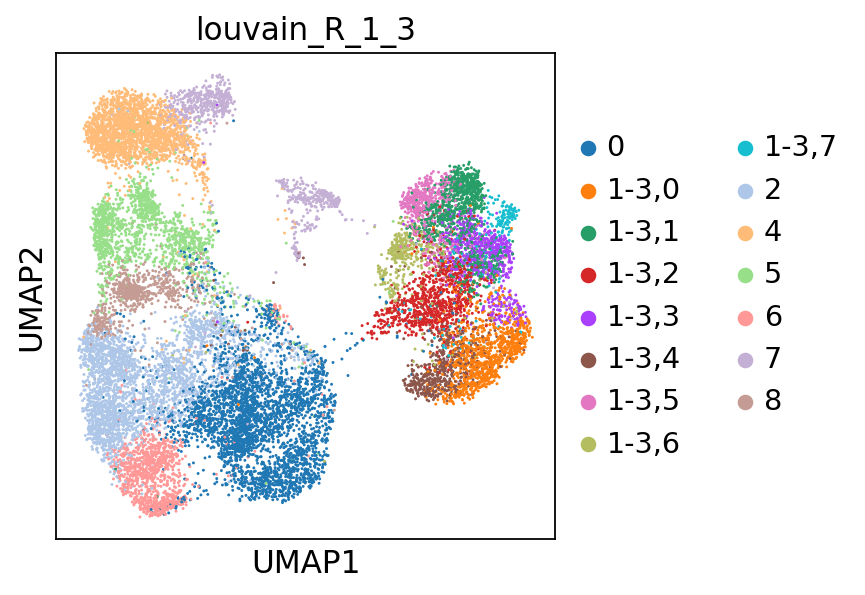

In [17]:
sc.pl.umap(adata, color=['louvain_R_1_3'])

In [21]:
# zoom in clustering of B cells
sc.tl.louvain(adata, resolution=0.5, restrict_to = ('louvain_R_1_3',['1-3,1']),
             key_added='louvain_R_naive_B_cells')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 17 clusters and added
    'louvain_R_naive_B_cells', the cluster labels (adata.obs, categorical) (0:00:00)


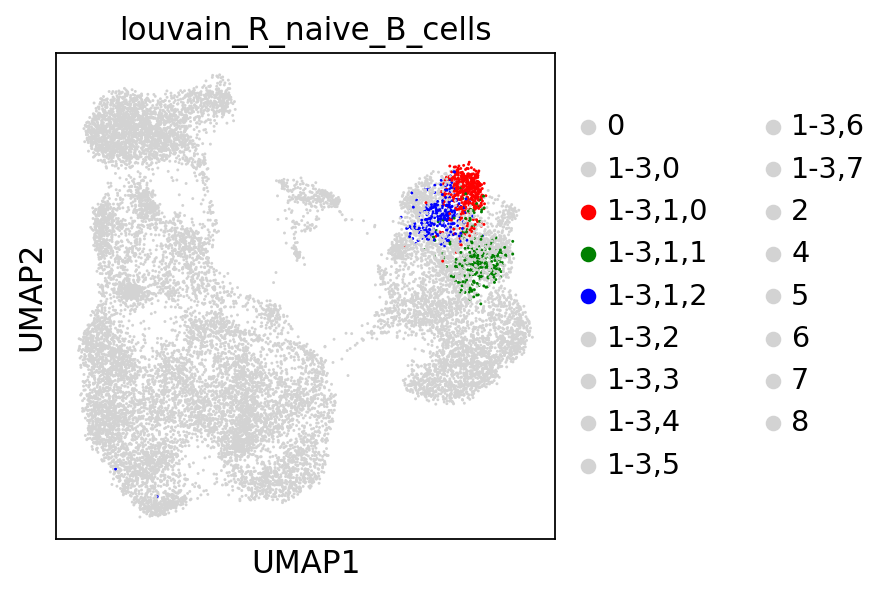

In [24]:
sc.pl.umap(adata, color=['louvain_R_naive_B_cells'],
          palette = ['lightgrey']*2 + ['red','green','blue',
           #'orange'
                                      ] + ['lightgrey']*12
          )

In [25]:
np.unique(adata.obs['louvain_R_naive_B_cells'])

array(['0', '1-3,0', '1-3,1,0', '1-3,1,1', '1-3,1,2', '1-3,2', '1-3,3',
       '1-3,4', '1-3,5', '1-3,6', '1-3,7', '2', '4', '5', '6', '7', '8'],
      dtype=object)

In [27]:
np.unique(adata.obs['cell_type_prev'])

array(['B:T_doublets_by_BCR', 'B_cells_memory',
       'B_cells_memory_activated', 'B_cells_naive',
       'B_cells_naive_activated', 'B_cells_oligoclonal', 'MAIT_cells',
       'MAIT_cells_activated', 'Myeloid_cells', 'NK_CD16_bright',
       'NK_CD16_bright_activated', 'NK_CD56_bright',
       'NK_CD56_bright_activated', 'T4_activated', 'T4_memory',
       'T4_naive', 'T8_activated_1', 'T8_activated_2', 'T8_memory',
       'T8_naive', 'T_gd', 'T_regs'], dtype=object)

In [28]:
def correct_B_cell_annotation(adata_obj, barcode):
    
    curr_louvain_R_naive_B_cells = adata_obj.obs.loc[barcode, 'louvain_R_naive_B_cells']
    
    curr_annotation = adata_obj.obs.loc[barcode, 'cell_type_prev']
    
    if curr_louvain_R_naive_B_cells == '1-3,1,1':
        # if it's a doublet, prioritise the doublet
        if curr_annotation == 'B:T_doublets_by_BCR':
            return(curr_annotation)
        # if it's not a doublet, reannotate into B_cells_naive_activated
        else:
            return('B_cells_naive_activated')
        
    # any other clusters - leave as they are    
    else:
        return(adata_obj.obs.loc[barcode, 'cell_type_prev'])
    

In [29]:
adata.obs['cell_type_corrected_final'] = adata.obs['barcode'].apply(lambda x: correct_B_cell_annotation(adata,x))

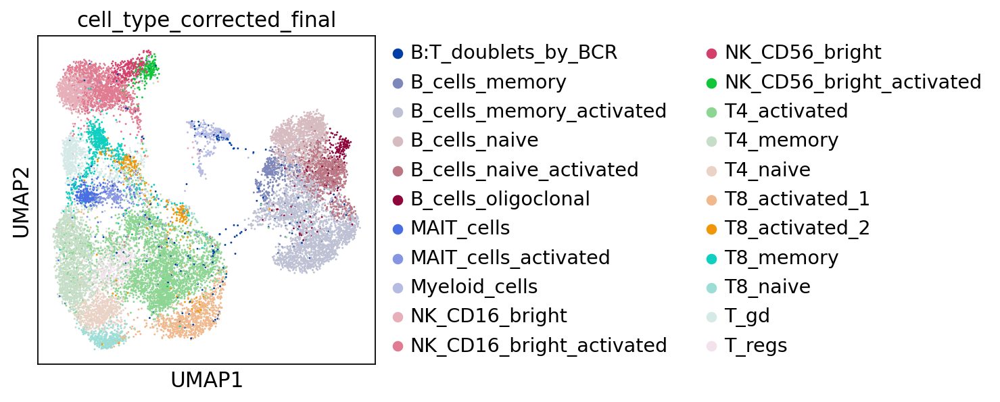

In [36]:
sc.pl.umap(adata, color='cell_type_corrected_final')

In [35]:
pd.DataFrame(adata.obs.loc[:,'cell_type_corrected_final']).to_csv(save_path + '20210322_annotation_twins_final.csv')

In [37]:
adata

AnnData object with n_obs × n_vars = 17315 × 2439
    obs: 'activation', 'barcode_sample', 'batch', 'bh_pval', 'condition', 'n_counts', 'n_genes', 'percent_mito', 'sample', 'scrublet_cluster_score', 'scrublet_score', 'technique', 'is_doublet', 'S_score', 'G2M_score', 'phase', 'probabilities', 'celltype_predictions', 'louvain', 'louvain_R_1_3', 'cell_type', 'barcode', 'louvain_R_7', 'louvain_R_7,0', 'louvain_R_4', 'louvain_R_5', 'louvain_R_8', 'louvain_R_2', 'louvain_R_2,1', 'louvain_R_0', 'louvain_R_6', 'GC_celltype_predictions', 'GC_celltype_prediction_probabilities', 'N_USM_SM_predictions', 'N_USM_SM_prediction_probabilities', 'naive_memory_predictions_Hamish', 'naive_memory_predictions_Hamish_probabilities', 'louvain_R_2,0', 'cell_type_prev', 'louvain_R_naive_B_cells', 'cell_type_corrected_final'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_

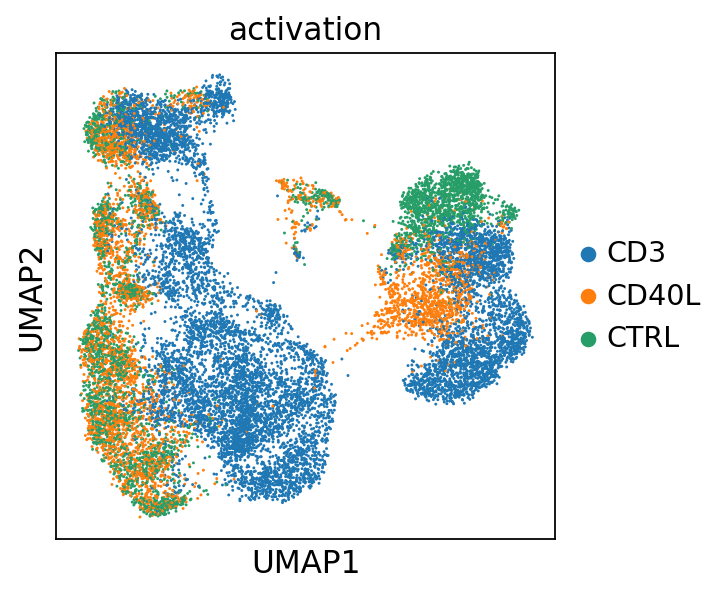

In [38]:
sc.pl.umap(adata, color='activation')

In [72]:
sc.settings.set_figure_params(dpi=80,
                             figsize=[10,10])  # low dpi (dots per inch) yields small inline figures

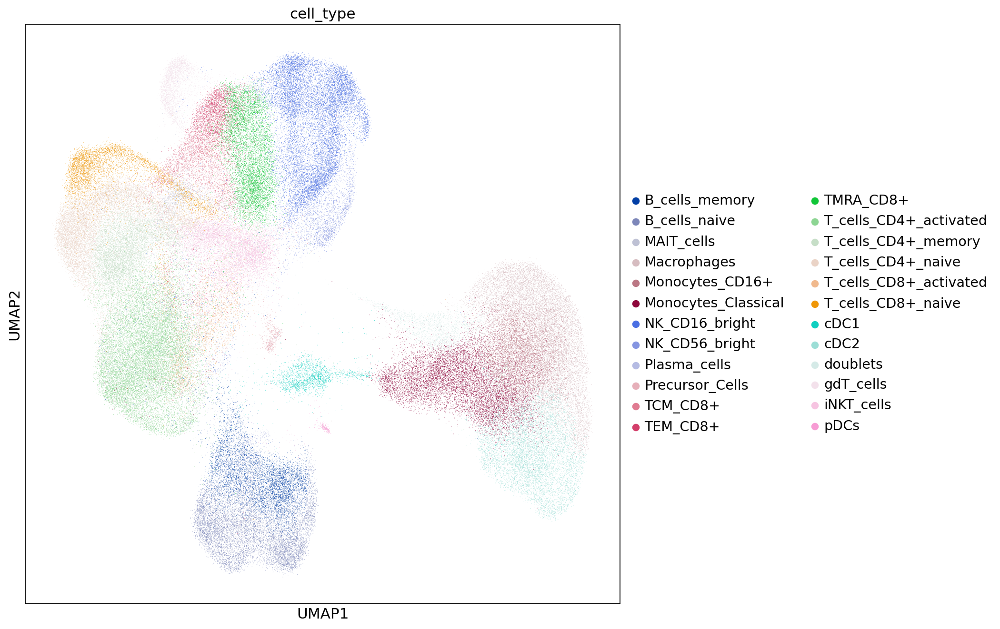

In [73]:
sc.pl.umap(adata, color='cell_type')

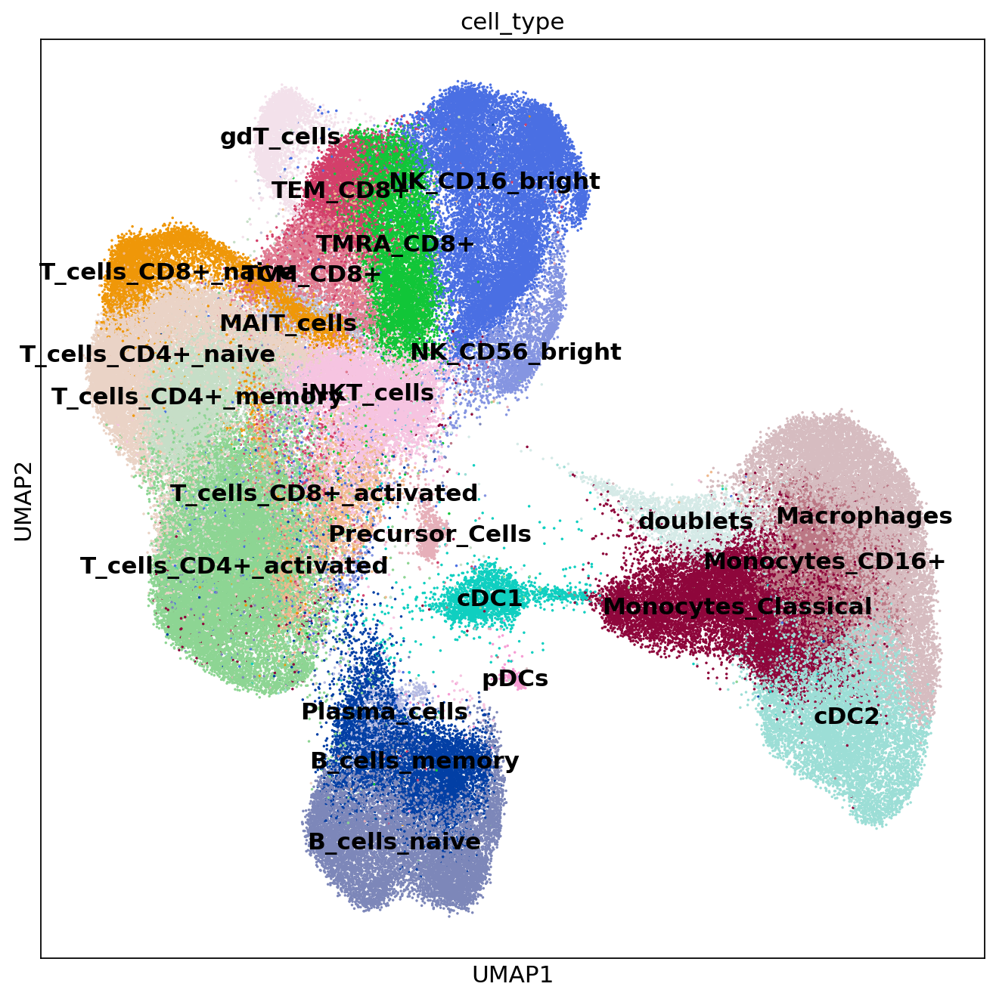

In [74]:
sc.pl.umap(adata, color='cell_type', legend_loc='on data', legend_fontweight='bold',
          size=10)

In [78]:
# also adding labels of doublets by BCR and doublets by TCR
doublets_BCR = pd.read_csv(save_path + 'doublets_by_BCR_table_20210106.csv', index_col=0)
doublets_TCR = pd.read_csv(save_path + 'doublets_by_TCR_table_20210106.csv', index_col=0)

In [80]:
doublets_BCR.shape

(163320, 1)

In [81]:
doublets_TCR.shape

(163320, 1)

In [82]:
np.unique(doublets_BCR['doublets_by_BCR'], return_counts=True)

(array([False,  True]), array([160951,   2369]))

In [83]:
np.unique(doublets_TCR['doublets_by_TCR'], return_counts=True)

(array([False,  True]), array([149897,  13423]))

In [84]:
def add_BCR_TCR_doublet_labels(adata_obj, barcode):
    
    curr_cell_type = adata_obj.obs.loc[barcode, 'cell_type']
    
    # priority to doublets by BCR over those by TCR but it's not important anyway, they are going to be excluded
    if doublets_BCR.loc[barcode, 'doublets_by_BCR']:
        return('doublets_by_BCR')
    elif doublets_TCR.loc[barcode, 'doublets_by_TCR']:
        return('doublets_by_TCR')
    else:
        return(curr_cell_type)

In [87]:
adata.obs['cell_type_final'] = adata.obs['barcode'].apply(lambda x: add_BCR_TCR_doublet_labels(adata, x))

... storing 'cell_type_final' as categorical


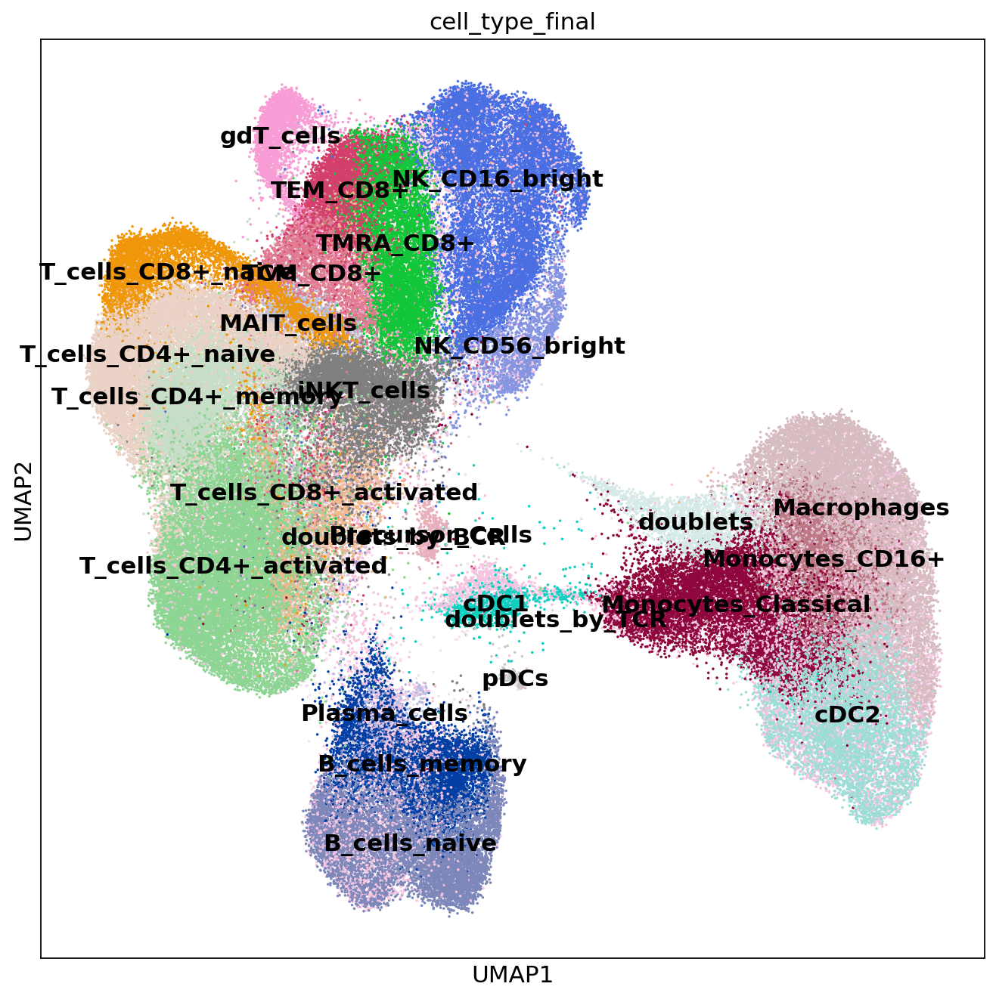

In [88]:
sc.pl.umap(adata, color='cell_type_final', legend_loc='on data', legend_fontweight='bold',
          size=10)

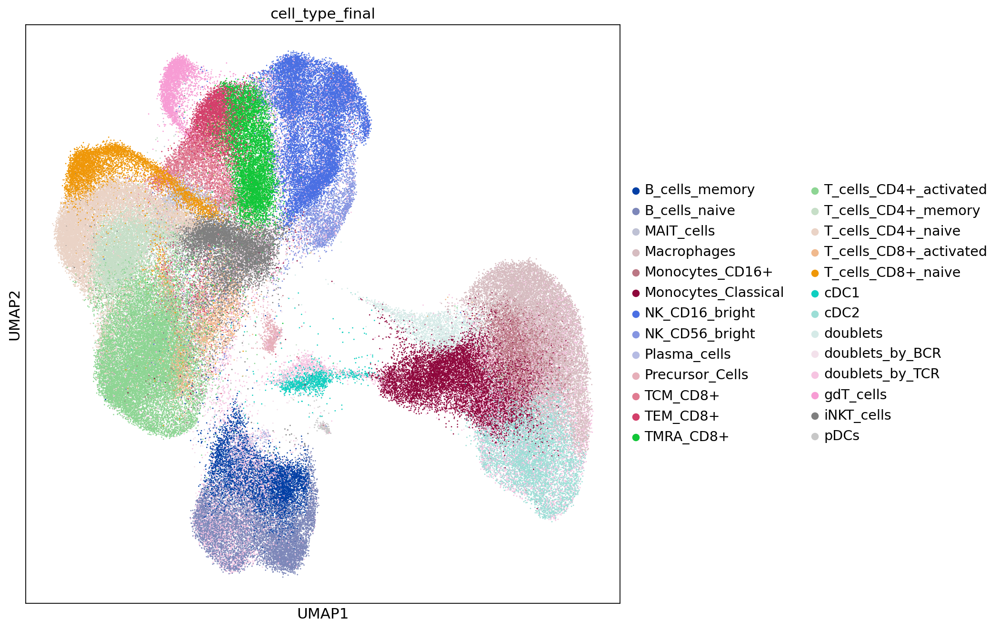

In [92]:
sc.pl.umap(adata, color='cell_type_final', 
           #legend_loc='on data', legend_fontweight='bold',
          size=6
          )

In [94]:
annot_table = adata.obs.loc[:,['cell_type_final']]

In [95]:
annot_table.head()

,cell_type_final
AAACCTGAGAATGTGT-1,Monocytes_CD16+
AAACCTGAGACTAAGT-1,cDC2
AAACCTGAGCCGCCTA-1,TCM_CD8+
AAACCTGAGCGCCTCA-1,TEM_CD8+
AAACCTGAGGATGTAT-1,TEM_CD8+


In [97]:
np.unique(annot_table['cell_type_final'])

array(['B_cells_memory', 'B_cells_naive', 'MAIT_cells', 'Macrophages',
       'Monocytes_CD16+', 'Monocytes_Classical', 'NK_CD16_bright',
       'NK_CD56_bright', 'Plasma_cells', 'Precursor_Cells', 'TCM_CD8+',
       'TEM_CD8+', 'TMRA_CD8+', 'T_cells_CD4+_activated',
       'T_cells_CD4+_memory', 'T_cells_CD4+_naive',
       'T_cells_CD8+_activated', 'T_cells_CD8+_naive', 'cDC1', 'cDC2',
       'doublets', 'doublets_by_BCR', 'doublets_by_TCR', 'gdT_cells',
       'iNKT_cells', 'pDCs'], dtype=object)

In [98]:
annot_table.to_csv(save_path + 'annotation_of_adata_hvg_BBKNN_GEX_and_SoupX_denoised_protein_all_samples_20210108.csv')

--> to notebok M2-2a

# DE with limma

In [128]:
# creating also the full object (all genes) - only normalised and log transformed
adata_all_full = anndata.AnnData(X=adata.raw.X,
                            obs=adata.obs,
                            var=adata.raw.var,
                            obsm=adata.obsm)

In [129]:
np.unique(adata_all_full.obs['annot'])

array(['B_cells', 'Class_Monocytes', 'Interm_Monocytes', 'MAIT_cells',
       'NKT_cells', 'NK_CD56_bright', 'NK_CD56_bright_activated',
       'NK_CD56_dim', 'NK_CD56_dim_activated', 'Non-class_Monocytes',
       'Plasma_cells', 'Precursor_cells', 'T4_memory',
       'T4_memory_activated', 'T4_naive', 'T4_naive_activated',
       'T8_memory', 'T8_memory_activated', 'T8_naive',
       'T8_naive_activated', 'cDC', 'gdT_cells', 'not_assigned_R_1'],
      dtype=object)

In [131]:
# want to have a look at CD4+ T cell compartment
adata_CD4_T = adata_all_full[adata_all_full.obs['annot'].isin(['T4_memory',
       'T4_memory_activated', 'T4_naive', 'T4_naive_activated'])]

In [132]:
adata_CD4_T

View of AnnData object with n_obs × n_vars = 24660 × 20209
    obs: 'batch', 'bh_pval', 'cell_id', 'dataset', 'n_counts', 'n_genes', 'percent_mito', 'sample', 'scrublet_cluster_score', 'scrublet_score', 'stimulation', 'technique', 'is_doublet', 'donor_ID_temp', 'S_score', 'G2M_score', 'phase', 'n_counts_protein', 'n_counts_protein_lognorm', 'louvain', 'prelim_annot', 'probabilities', 'celltype_predictions', 'barcode', 'donor', 'Age', 'Sex', 'Age of disease onset', 'Autoimmunity', 'Gastrointestinal disease', 'Lung disease (bronchiectasis)', 'Lymphoadenopathy ', 'Splenomegaly', 'History of hypogammaglobulinemia, IgA deficiency or immunodeficiency in other family members', 'CVID_status', 'louvain_R_1', 'louvain_R_5', 'louvain_R_7', 'louvain_R_17', 'louvain_R_3', 'louvain_R_3,4', 'annot'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature

In [133]:
# marker calling

#t = adata_hvg.X.toarray().T
t = adata_CD4_T.X.toarray().T
df = pd.DataFrame(data=t, columns= adata_CD4_T.obs.index, index=adata_CD4_T.var_names)

meta_df = pd.DataFrame(data={'Cell':list(adata_CD4_T.obs.index),
                             'cell_type':[ str(i) for i in adata_CD4_T.obs['CVID_status']],
                             'sample':[ str(i) for i in adata_CD4_T.obs['sample']]})
meta_df.set_index('Cell', inplace=True)

In [134]:
meta_df

,cell_type,sample
Cell,,
AAACCTGAGGCTAGCA-1,CONTROL,35008_CV005_RV9039258_and_35008_CV005_RV9039282
AAACCTGAGTACTTGC-1,CVID,35008_CV005_RV9039258_and_35008_CV005_RV9039282
AAACCTGAGTTCGATC-1,CVID,35008_CV005_RV9039258_and_35008_CV005_RV9039282
AAACCTGCACCAGTTA-1,CVID,35008_CV005_RV9039258_and_35008_CV005_RV9039282
AAACCTGCACGACGAA-1,CVID,35008_CV005_RV9039258_and_35008_CV005_RV9039282
...,...,...
TTTGGTTTCTTGTCAT-1,CONTROL,35008_CV005_RV9039265_and_35008_CV005_RV9039289
TTTGTCAAGGCCCGTT-1,CVID,35008_CV005_RV9039265_and_35008_CV005_RV9039289
TTTGTCAAGTACGATA-1-1,CONTROL,35008_CV005_RV9039265_and_35008_CV005_RV9039289


In [135]:
np.unique(meta_df['cell_type'], return_counts=True)

(array(['CONTROL', 'CVID'], dtype=object), array([14277, 10383]))

In [136]:
%load_ext rpy2.ipython

In [137]:
outpath = './10X_B_cells_DE_limma/'

In [138]:
%%R
library(limma)
library(edgeR)

In [139]:
meta_df.reset_index(inplace=True)

In [140]:
meta_df

,Cell,cell_type,sample
0,AAACCTGAGGCTAGCA-1,CONTROL,35008_CV005_RV9039258_and_35008_CV005_RV9039282
1,AAACCTGAGTACTTGC-1,CVID,35008_CV005_RV9039258_and_35008_CV005_RV9039282
2,AAACCTGAGTTCGATC-1,CVID,35008_CV005_RV9039258_and_35008_CV005_RV9039282
3,AAACCTGCACCAGTTA-1,CVID,35008_CV005_RV9039258_and_35008_CV005_RV9039282
4,AAACCTGCACGACGAA-1,CVID,35008_CV005_RV9039258_and_35008_CV005_RV9039282
...,...,...,...
24655,TTTGGTTTCTTGTCAT-1,CONTROL,35008_CV005_RV9039265_and_35008_CV005_RV9039289
24656,TTTGTCAAGGCCCGTT-1,CVID,35008_CV005_RV9039265_and_35008_CV005_RV9039289
24657,TTTGTCAAGTACGATA-1-1,CONTROL,35008_CV005_RV9039265_and_35008_CV005_RV9039289
24658,TTTGTCAGTCTTCTCG-1,CONTROL,35008_CV005_RV9039265_and_35008_CV005_RV9039289


In [141]:
# because R replace '-' with '.' in df for some reason
def rename_Cell(cell_id):
    return(cell_id.replace('-','.'))

In [142]:
meta_df['Cell'] = meta_df['Cell'].apply(lambda x: rename_Cell(x))

In [143]:
meta_df

,Cell,cell_type,sample
0,AAACCTGAGGCTAGCA.1,CONTROL,35008_CV005_RV9039258_and_35008_CV005_RV9039282
1,AAACCTGAGTACTTGC.1,CVID,35008_CV005_RV9039258_and_35008_CV005_RV9039282
2,AAACCTGAGTTCGATC.1,CVID,35008_CV005_RV9039258_and_35008_CV005_RV9039282
3,AAACCTGCACCAGTTA.1,CVID,35008_CV005_RV9039258_and_35008_CV005_RV9039282
4,AAACCTGCACGACGAA.1,CVID,35008_CV005_RV9039258_and_35008_CV005_RV9039282
...,...,...,...
24655,TTTGGTTTCTTGTCAT.1,CONTROL,35008_CV005_RV9039265_and_35008_CV005_RV9039289
24656,TTTGTCAAGGCCCGTT.1,CVID,35008_CV005_RV9039265_and_35008_CV005_RV9039289
24657,TTTGTCAAGTACGATA.1.1,CONTROL,35008_CV005_RV9039265_and_35008_CV005_RV9039289
24658,TTTGTCAGTCTTCTCG.1,CONTROL,35008_CV005_RV9039265_and_35008_CV005_RV9039289


In [144]:
df

index,AAACCTGAGGCTAGCA-1,AAACCTGAGTACTTGC-1,AAACCTGAGTTCGATC-1,AAACCTGCACCAGTTA-1,AAACCTGCACGACGAA-1,AAACCTGTCAATACCG-1,AAACGGGAGAACTGTA-1,AAACGGGTCGGTCCGA-1,AAACGGGTCTTTAGTC-1,AAAGATGAGGTGGGTT-1,...,TTTGGTTCAGCCTATA-1,TTTGGTTCAGTTCATG-1,TTTGGTTGTAGCAAAT-1-1,TTTGGTTGTGAAATCA-1,TTTGGTTTCCGCATAA-1,TTTGGTTTCTTGTCAT-1,TTTGTCAAGGCCCGTT-1,TTTGTCAAGTACGATA-1-1,TTTGTCAGTCTTCTCG-1,TTTGTCATCGCTGATA-1
index,,,,,,,,,,,,,,,,,,,,,
RP11-34P13.7,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
FO538757.2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
AP006222.2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
RP4-669L17.10,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
RP5-857K21.4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AC091133.1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
TENM2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
RP11-22A3.2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [145]:
np.unique(meta_df['cell_type'], return_counts=True)

(array(['CONTROL', 'CVID'], dtype=object), array([14277, 10383]))

In [146]:
# doing for all nonCVID B cells, comparing GC-like B cells vs other B cells
case = 'CVID'
ctrl = 'CONTROL'

In [147]:
%%R -i df -i meta_df -i outpath -i ctrl -i case 

library(limma)
library(edgeR)

# Format
ex_mat=as.matrix(df)
rownames(meta_df) = meta_df$Cell

# subset meta
meta_df = subset(meta_df, cell_type %in% unlist(c(ctrl, case)) )
print(unique(meta_df$cell_type))

# Shared cells
shared_cells = intersect(rownames(meta_df), colnames(ex_mat))
message(length(shared_cells), ' shared cells')
ex_mat = ex_mat[, shared_cells]
meta_df = meta_df[shared_cells,]

# Filter lowly expressed genes
keep = rowSums(ex_mat, na.rm=T) > 0.1
ex_mat = ex_mat[ keep, ]
keep = aveLogCPM(ex_mat) > 0.1
ex_mat = ex_mat[ keep, ]

# Extract celltypes
cells = rownames(meta_df)
celltypes = unique(meta_df$cell_type)
covariates = meta_df$covariate

# Extract cells in cluster and rest
cells_case = rownames(subset(meta_df, cell_type == case))
cells_ctrl = rownames(subset(meta_df, cell_type == ctrl)) # changed from control to ctrl

# build cluster_type vector
cluster_type = rep(0, length(cells))
names(cluster_type) = cells
cluster_type[ cells_case ] = 'case'
cluster_type[ cells_ctrl ] = 'ctrl'

print(unique(cluster_type))

#design.matrix <- model.matrix(~ 0 + cluster_type + covariates)
design.matrix <- model.matrix(~ 0 + cluster_type)

# Now tell limma how do you want to compare (i.e. case vs control)
contrast.matrix <- makeContrasts(caseVScontrol = cluster_typecase - cluster_typectrl, levels = design.matrix)

# Make model and run contrasts
fit <- lmFit(ex_mat, design.matrix)
fit <- contrasts.fit(fit, contrast.matrix)
fit <- eBayes(fit)

# Make a dataframe containing the important data
results = topTable(fit, adjust="fdr", number = nrow(ex_mat), coef = 'caseVScontrol')

# Add and filter needed data
results$Gene = rownames(results)
results = results[ , c('Gene', 'logFC', 'P.Value', 'adj.P.Val')]
results$AveExpr_cluster = apply(ex_mat[ results$Gene, cells_case], 1, mean)
results$AveExpr_rest = apply(ex_mat[ results$Gene, cells_ctrl], 1, mean)
results$percentExpr_cluster = apply(ex_mat[ results$Gene, cells_case], 1, function(x) sum(c(x > 0)+0) ) / length(cells_case)
results$percentExpr_rest = apply(ex_mat[ results$Gene, cells_ctrl], 1, function(x) sum(c(x > 0)+0) ) / length(cells_ctrl)

results$AveExpr_cluster = round(results$AveExpr_cluster, 6)
results$AveExpr_rest = round(results$AveExpr_rest, 6)
results$percentExpr_cluster = round(results$percentExpr_cluster, 6)
results$percentExpr_rest = round(results$percentExpr_rest, 6)
# and store it as csv file
write.csv(results, file = paste0(outpath, case, '_vs_', ctrl, '_CD4_T_cells_limma_DEGs.csv'), row.names = F, col.names = T, quote = F)

[1] "CONTROL" "CVID"   


R[write to console]: 24660 shared cells



[1] "ctrl" "case"


In [148]:
DE_table = pd.read_csv('./10X_B_cells_DE_limma/CVID_vs_CONTROL_CD4_T_cells_limma_DEGs.csv', index_col=0)

In [151]:
for gene in DE_table.index:
    if 'CD40' in gene:
        print(gene)

CD40LG
CD40-1
CD40


In [152]:
DE_table.loc['CD40LG']

logFC                 -6.672630e-02
P.Value                3.208165e-15
adj.P.Val              4.016276e-13
AveExpr_cluster        2.488950e-01
AveExpr_rest           3.156220e-01
percentExpr_cluster    1.577580e-01
percentExpr_rest       1.958390e-01
Name: CD40LG, dtype: float64

In [154]:
adata_CD4_T

View of AnnData object with n_obs × n_vars = 24660 × 20209
    obs: 'batch', 'bh_pval', 'cell_id', 'dataset', 'n_counts', 'n_genes', 'percent_mito', 'sample', 'scrublet_cluster_score', 'scrublet_score', 'stimulation', 'technique', 'is_doublet', 'donor_ID_temp', 'S_score', 'G2M_score', 'phase', 'n_counts_protein', 'n_counts_protein_lognorm', 'louvain', 'prelim_annot', 'probabilities', 'celltype_predictions', 'barcode', 'donor', 'Age', 'Sex', 'Age of disease onset', 'Autoimmunity', 'Gastrointestinal disease', 'Lung disease (bronchiectasis)', 'Lymphoadenopathy ', 'Splenomegaly', 'History of hypogammaglobulinemia, IgA deficiency or immunodeficiency in other family members', 'CVID_status', 'louvain_R_1', 'louvain_R_5', 'louvain_R_7', 'louvain_R_17', 'louvain_R_3', 'louvain_R_3,4', 'annot'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature

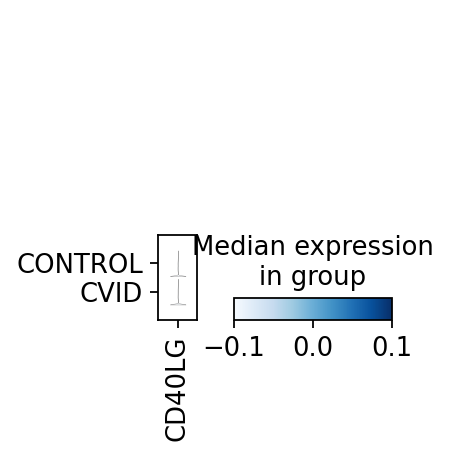

In [155]:
sc.pl.stacked_violin(adata_CD4_T, 
                         ['CD40LG'],
                         groupby = 'CVID_status',
                    save='_CD4_T_cells_violin_plot.pdf')

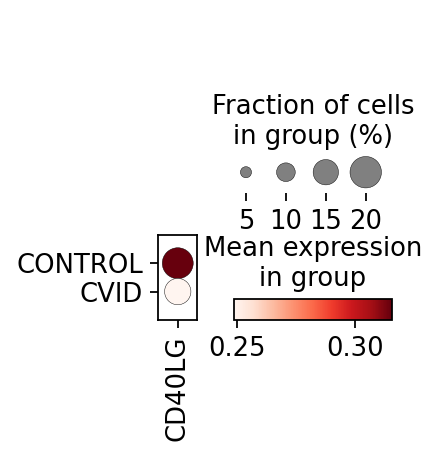

In [156]:
sc.pl.dotplot(adata_CD4_T, 
                         ['CD40LG'],
                         groupby = 'CVID_status',
                    save='_CD4_T_cells.pdf')

Trying to set attribute `.uns` of view, copying.


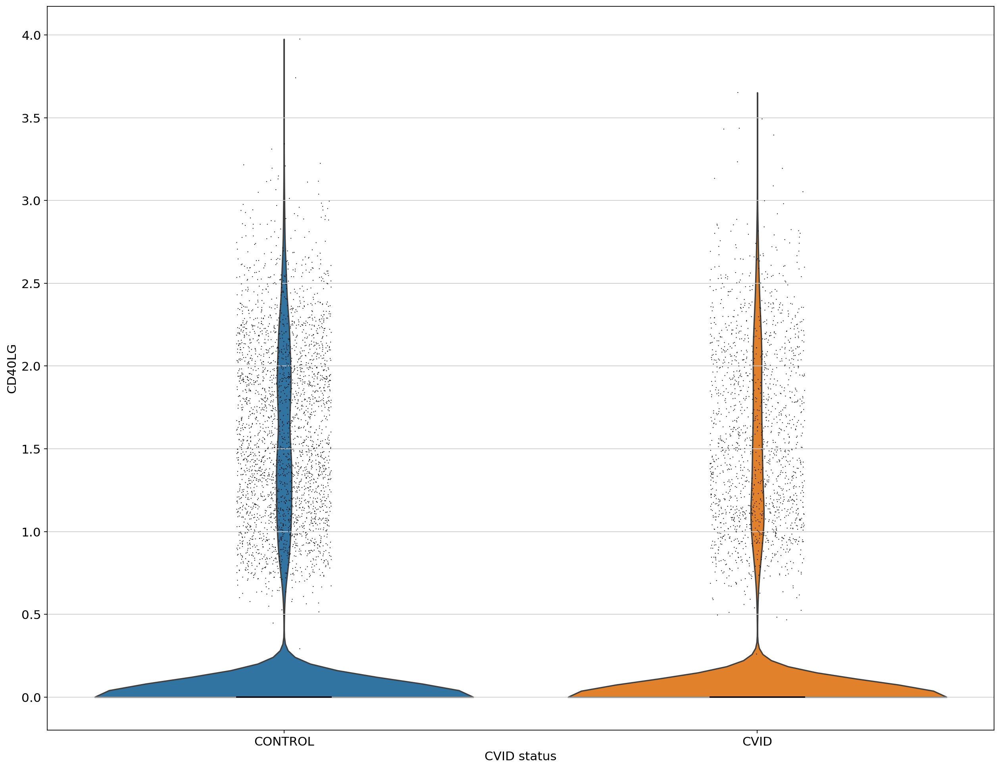

In [157]:
sc.pl.violin(adata_CD4_T, 
                         ['CD40LG'],
                         groupby = 'CVID_status',
                    save='_CD4_T_cells.pdf')

In [153]:
DE_table

,logFC,P.Value,adj.P.Val,AveExpr_cluster,AveExpr_rest,percentExpr_cluster,percentExpr_rest
Gene,,,,,,,
RPS4Y1,6.406594e-01,0.000000e+00,0.000000e+00,1.493042,0.852383,0.678609,0.407018
MT2A,-3.728604e-01,3.539666e-108,3.279147e-104,0.940054,1.312915,0.428585,0.512433
XIST,-8.877900e-02,1.751247e-101,1.081570e-97,0.010996,0.099775,0.007416,0.066471
MT1E,-1.889162e-01,9.035516e-96,4.185251e-92,0.237521,0.426437,0.155543,0.255446
RPS26,-3.226608e-01,1.854109e-93,6.870586e-90,2.530541,2.853202,0.819127,0.892274
...,...,...,...,...,...,...,...
ZNF837,-3.682926e-07,9.996968e-01,9.999109e-01,0.003428,0.003428,0.002504,0.002171
TTF1,-1.162249e-06,9.998228e-01,9.999109e-01,0.104146,0.104148,0.068381,0.072774
RIMS3,1.123980e-07,9.998713e-01,9.999109e-01,0.001879,0.001879,0.001348,0.001401


In [ ]:
# if not, try to only compare only activated T cell states

In [90]:
# to get the barcode-sample column stored here as 'cell_id'
adata_raw_filtered = sc.read(save_path+'adata_raw_filtered.h5ad')

In [91]:
adata.obs['barcode_sample'] = adata_raw_filtered.obs.loc[adata.obs.index,'cell_id']

In [95]:
adata.obs['prelim_annot']

index
AAACCTGAGAATGTGT-1      Monocyte-derived_cells
AAACCTGAGACTAAGT-1                         DCs
AAACCTGAGCCGCCTA-1                  MAIT_cells
AAACCTGAGCGCCTCA-1                   T8_memory
AAACCTGAGGATGTAT-1                   T8_memory
                                 ...          
TTTGTCATCATCGATG-1      Monocyte-derived_cells
TTTGTCATCATCGCTC-1                         NK1
TTTGTCATCCTTAATC-1                         NK1
TTTGTCATCGCTGATA-1                    T8_naive
TTTGTCATCTAACTCT-1-1                 Monocytes
Name: prelim_annot, Length: 92749, dtype: category
Categories (21, object): [B_cells, DCs, MAIT_cells, Monocyte-derived_cells, ..., T8_memory, T8_naive, T8_naive_activated, gdT]

In [99]:
for sample in np.unique(adata.obs['sample']):
    print(sample)
    curr_data = adata[adata.obs['sample'] == sample]
    annot_df = pd.DataFrame(index=curr_data.obs['barcode_sample'])
    annot_df['cell_type'] = list(curr_data.obs['prelim_annot'])
    annot_df.index = [elem.split('_')[0] for elem in annot_df.index]
    print(annot_df)
    annot_df.to_csv('./annot_tables_for_SoupX/20201008_prelim_annot_8_samples_annot_sample_'+sample+'.csv')

35008_CV005_RV9039258_and_35008_CV005_RV9039282
                                 cell_type
AAACCTGAGAATGTGT-1  Monocyte-derived_cells
AAACCTGAGACTAAGT-1                     DCs
AAACCTGAGCCGCCTA-1              MAIT_cells
AAACCTGAGCGCCTCA-1               T8_memory
AAACCTGAGGATGTAT-1               T8_memory
...                                    ...
TTTGTCATCTAACCGA-1      T8_naive_activated
TTTGTCATCTATCCCG-1                T8_naive
TTTGTCATCTCAAGTG-1                     DCs
TTTGTCATCTCTGAGA-1                T4_naive
TTTGTCATCTGTTGAG-1  Monocyte-derived_cells

[13571 rows x 1 columns]
35008_CV005_RV9039259_and_35008_CV005_RV9039283
                                 cell_type
AAACCTGAGACACTAA-1                T4_naive
AAACCTGAGATTACCC-1  Monocyte-derived_cells
AAACCTGAGCACCGCT-1                T8_naive
AAACCTGAGCATCATC-1              MAIT_cells
AAACCTGAGCGTCTAT-1                     DCs
...                                    ...
TTTGTCATCGGTTAAC-1  Monocyte-derived_cells
TTTGTCATCGTAGGAG-1